# 6. Latent-mixture models

* 싸이그래머 / 인지모델링:베이지안[1]
* 김무성

# Contents

* 6.1 Exam scores
* 6.2 Exam scores with individual differences
* 6.3 Twenty questions
* 6.4 The two-country quiz
* 6.5 Assessment of malingering
* 6.6 Individual differences in malingering
* 6.7 Alzheimer’s recall test cheating

# 6.1 Exam scores

* Suppose a group of <font color="red">15 people</font> sit an exam made up of <font color="red">40 true-or-false questions</font>, and they get <font color="red">21, 17, 21, 18, 22, 31, 31, 34, 34, 35, 35, 36, 39, 36, and 35 right</font>. These scores suggest that the first <font color="blue">5 people were just guessing</font>, but the last <font color="orange">10 had some level of knowledge</font>.
* One way to make statistical inferences along these lines is to assume there are two different groups of people. 
    - These groups have different probabilities of success, with 
        - the <font color="blue">guessing group</font> having a probability of <font color="blue">0.5</font>, and 
        - the <font color="orange">knowledge group</font> having a probability <font color="orange">greater than 0.5</font>. 
    - Whether <font color="red">each person belongs</font> to the first or the second group is a <font color="red">latent or unobserved variable</font> that can take just two values.    
* Using this approach, the goal is to infer 
    - to <font color="red">which group each person belongs</font>, and also 
    - the <font color="red">rate of success for the knowledge group</font>.    

<img src="figures/fig6.1.png" width=600 />

* The number of correct answers for the ith person is <font color="red">ki</font>, 
* and is out of <font color="red">n</font> = 40. 
* The probability of success on each question for the ith person is the rate <font color="red">θi</font>. 
    - This rate is either <font color="red">ψ</font>,if the person is in the guessing group, 
    - or <font color="red">φ</font> if the person is in the knowledge group.
* Which group the ith person belongs to is determined by a binary indicator variable <font color="red">zi</font>, with zi = 0 if the ith person is in the guessing group, and zi = 1 if the ith person is in the knowledge group.
    

* This type of model is known as a latent-mixture model, 
    - because the data are assumed to be generated by two different processes that combine or mix, and 
    - important properties of that mixture are unobserved or latent. 
    - In this case, 
        - the two components that <font color="red">mix</font> are the <font color="red">guessing and knowledge processes</font>, and 
        - the <font color="blue"> group membership</font> of each person is <font color="blue">latent</font>.

### JAGS code

In [40]:
library(R2jags)

In [41]:
# Exam Scores
s = "
model{
  # Each Person Belongs To One Of Two Latent Groups
  for (i in 1:p){
    z[i] ~ dbern(0.5)
  }
  # First Group Guesses
  psi <- 0.5
  # Second Group Has Some Unknown Greater Rate Of Success
  phi ~ dbeta(1,1)I(0.5,1)
  # Data Follow Binomial With Rate Given By Each Person's Group Assignment
  for (i in 1:p){
    theta[i] <- equals(z[i],0)*psi+equals(z[i],1)*phi
    k[i] ~ dbin(theta[i],n)
  }
}
"

In [43]:
k <- c(21,17,21,18,22,31,31,34,34,35,35,36,39,36,35)
p <- length(k) #number of people
n <- 40 # number of questions

In [44]:
data <- list("p", "k", "n") # to be passed on to JAGS
myinits <- list(
  list(phi = 0.75, z = round(runif(p)))) # Initial group assignment

In [45]:
# parameters to be monitored:
parameters <- c("phi","z")

In [46]:
# The following command calls JAGS with specific options.
# For a detailed description see the R2jags documentation.
samples <- jags(data, inits=myinits, parameters,
                textConnection(s), n.chains=1, n.iter=1000, 
                n.burnin=1, n.thin=1, DIC=T)
# Now the values for the monitored parameters are in the "samples" object, 
# ready for inspection.

module glm loaded


Compiling model graph
   Resolving undeclared variables
   Allocating nodes
   Graph Size: 112

Initializing model



In [47]:
samples

Inference for Bugs model at "4", fit using jags,
 1 chains, each with 1000 iterations (first 1 discarded)
 n.sims = 999 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%
phi        0.863   0.017  0.827  0.853  0.863  0.875  0.896
z[1]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
z[2]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
z[3]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
z[4]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
z[5]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
z[6]       0.993   0.083  1.000  1.000  1.000  1.000  1.000
z[7]       0.991   0.095  1.000  1.000  1.000  1.000  1.000
z[8]       1.000   0.000  1.000  1.000  1.000  1.000  1.000
z[9]       1.000   0.000  1.000  1.000  1.000  1.000  1.000
z[10]      1.000   0.000  1.000  1.000  1.000  1.000  1.000
z[11]      1.000   0.000  1.000  1.000  1.000  1.000  1.000
z[12]      1.000   0.000  1.000  1.000  1.000  1.000  1.000
z[13]      1.000   0.00

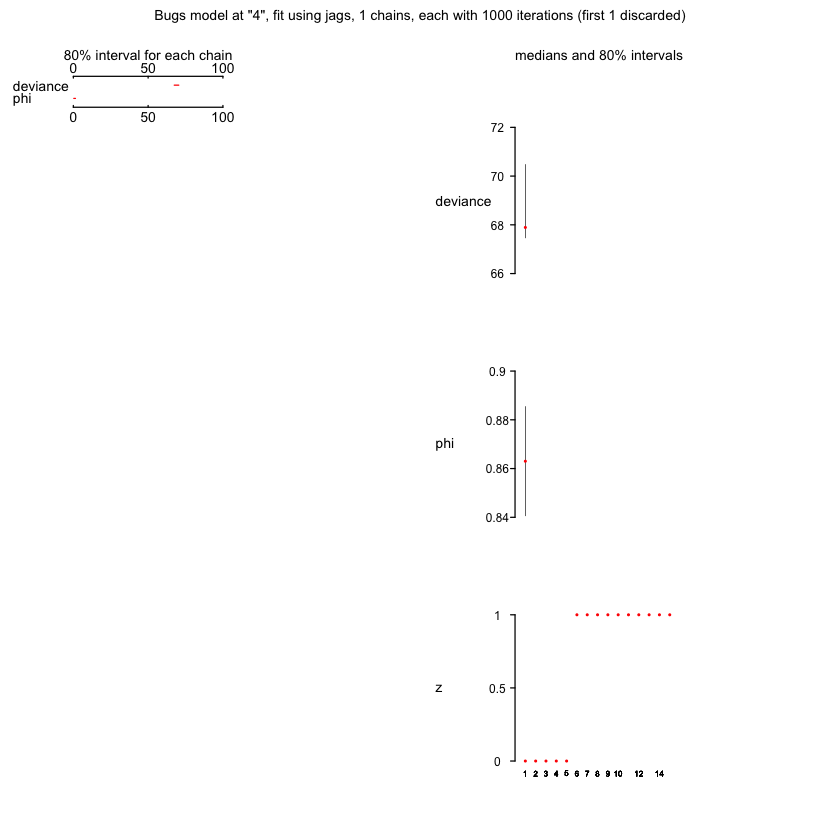

In [48]:
plot(samples)

### Stan code

In [50]:
library(rstan)

In [51]:
model <- "
// Exam Scores
data { 
  int<lower=1> p;
  int<lower=0> k[p];
  int<lower=1> n;
}
transformed data {
  real psi;

  // First Group Guesses
  psi <- .5;
}
parameters {
  // Second Group Has Some Unknown Greater Rate Of Success
  real<lower=.5,upper=1> phi; 
} 
transformed parameters {
  vector[2] lp_parts[p];

  // Data Follow Binomial With Rate Given By Each Person's Group Assignment
  for (i in 1:p) {
    lp_parts[i,1] <- log(.5) + binomial_log(k[i], n, phi);
    lp_parts[i,2] <- log(.5) + binomial_log(k[i], n, psi); 
  }
}
model {
  for (i in 1:p)
    increment_log_prob(log_sum_exp(lp_parts[i]));  
}
generated quantities {
  int<lower=0,upper=1> z[p];
  
  for (i in 1:p) {
    vector[2] prob;
    prob <- softmax(lp_parts[i]);
    z[i] <- bernoulli_rng(prob[1]);
  }
}"

In [52]:
k <- c(21, 17, 21, 18, 22, 31, 31, 34, 34, 35, 35, 36, 39, 36, 35)
p <- length(k)  # number of people
n <- 40  # number of questions

In [53]:
data <- list(p=p, k=k, n=n) # to be passed on to Stan

In [54]:
myinits <- list(
  list(phi=.75))
  
parameters <- c("phi", "z")  # parameters to be monitored

In [56]:
# The following command calls Stan with specific options.
# For a detailed description type "?rstan".
samples <- stan(model_code=model,   
                data=data, 
                init=myinits,  # If not specified, gives random inits
                pars=parameters,
                iter=1000, 
                chains=1, 
                thin=1,
                # warmup = 100,  # Stands for burn-in; Default = iter/2
                # seed = 123  # Setting seed; Default is random seed
)
# Now the values for the monitored parameters are in the "samples" object, 
# ready for inspection.


TRANSLATING MODEL 'model' FROM Stan CODE TO C++ CODE NOW.
COMPILING THE C++ CODE FOR MODEL 'model' NOW.
In file included from file37947c79fd3.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:17:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev.hpp:5:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev/chainable.hpp:87:17: warning: 'static' function 'set_zero_all_adjoints' declared in header file should be declared 'static inline' [-Wunneeded-internal-declaration]
    static void set_zero_all_adjoints() {
                ^
In file included from file37947c79fd3.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:21:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/

In [57]:
print(samples, digits=3)

Inference for Stan model: model.
1 chains, each with iter=1000; warmup=500; thin=1; 
post-warmup draws per chain=500, total post-warmup draws=500.

         mean se_mean    sd    2.5%     25%     50%     75%   97.5% n_eff  Rhat
phi     0.863   0.001 0.017   0.826   0.853   0.864   0.876   0.892   207 1.000
z[1]    0.000   0.000 0.000   0.000   0.000   0.000   0.000   0.000   500   NaN
z[2]    0.000   0.000 0.000   0.000   0.000   0.000   0.000   0.000   500   NaN
z[3]    0.000   0.000 0.000   0.000   0.000   0.000   0.000   0.000   500   NaN
z[4]    0.000   0.000 0.000   0.000   0.000   0.000   0.000   0.000   500   NaN
z[5]    0.000   0.000 0.000   0.000   0.000   0.000   0.000   0.000   500   NaN
z[6]    0.996   0.003 0.063   1.000   1.000   1.000   1.000   1.000   500 1.002
z[7]    1.000   0.000 0.000   1.000   1.000   1.000   1.000   1.000   500   NaN
z[8]    1.000   0.000 0.000   1.000   1.000   1.000   1.000   1.000   500   NaN
z[9]    1.000   0.000 0.000   1.000   1.000   1.000 

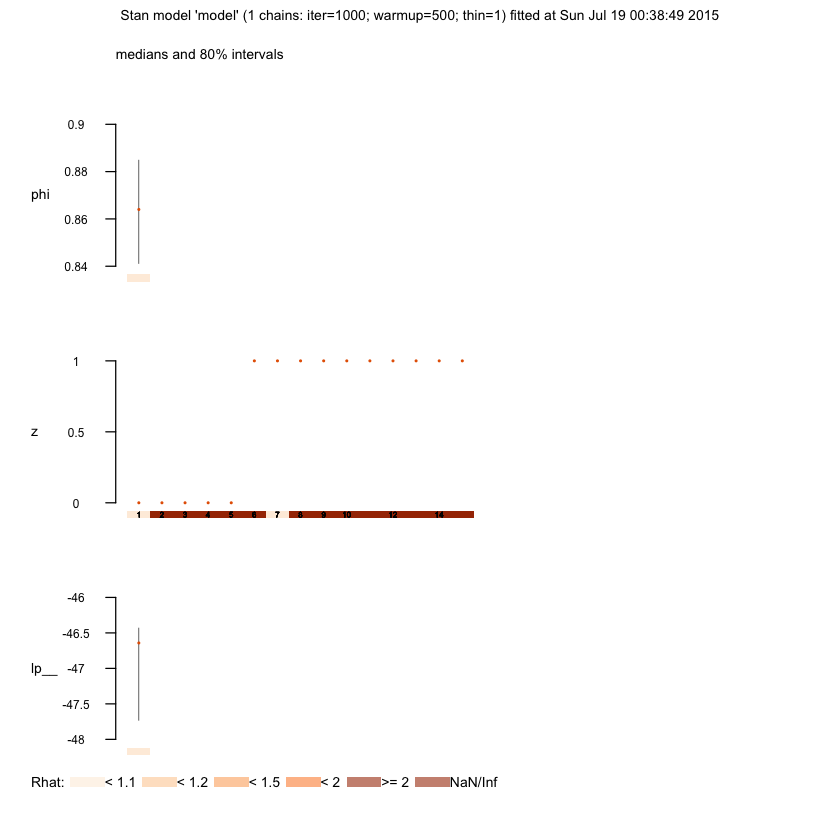

In [58]:
plot(samples)

# 6.2 Exam scores with individual differences

The previous example shows how sampling can model data as coming from a mixture of sources, and infer properties of these latent groups. But the specific model has at least <font color="red">one big weakness, which is that it assumes all the people in the knowledge group have exactly the same rate of success on the questions</font>.

* One straightforward way to allow for <font color="red">individual differences</font> in the knowledge group is to <font color="red">extend the model hierarchically</font>. 
* This involves drawing the success rate for each of the people in the knowledge group from an over-arching distribution. 
    - One convenient (but not perfect) choice for this <font color="red">“individual differences” distribution is a Gaussian</font>. 
    - It is a natural statistical model for individual variation, <font color="red">at least in the absence of any richer theory</font>. 
    - But it has the <font color="red">problem of allowing for success rates below zero and above one</font>. 
    - An inelegant but practical and effective way to deal with this is <font color="red">simply to restrict</font> the sampled success rates to <font color="red">the valid range</font>.

<img src="figures/fig6.2.png" width=600 />

### JAGS code

In [88]:
# Exam Scores With Individual Differences
s <- "
model{
  # Data Follow Binomial With Rate Given By Each Person's Group Assignment
  for (i in 1:p){
    theta[i] <- equals(z[i],0)*psi+equals(z[i],1)*phi[i]
    k[i] ~ dbin(theta[i],n)
  }
  # Each Person Belongs To One Of Two Latent Groups
  for (i in 1:p){
    z[i] ~ dbern(0.5)
  }
  # The Second Group Allows Individual Differences
  for (i in 1:p){
    # Second Group Drawn From A Censored Gaussian Distribution
    phi[i] ~ dnorm(mu,lambda)T(0,1)
  }   
  # First Group Guesses
  psi <- 0.5
  # Second Group Mean, Precision (And Standard Deviation)
  mu ~ dbeta(1,1)T(.5,1) # >0.5 Average Success Rate
  lambda ~ dgamma(.001,.001)
  sigma <- 1/sqrt(lambda) 
  # Posterior Predictive For Second Group
  predphi ~ dnorm(mu,lambda)T(0,1)
}
"

In [89]:
k <- c(21,17,21,18,22,31,31,34,34,35,35,36,39,36,35)
p <- length(k) #number of people
n <- 40 # number of questions

In [90]:
data <- list("p", "k", "n") # to be passed on to JAGS

In [91]:
myinits <- list(
  list(mu = 0.75, lambda = 1, z = round(runif(p)))) # Initial group assignment

In [92]:
# parameters to be monitored: 
parameters <- c("predphi","theta","z","mu","sigma")

In [93]:
# The following command calls JAGS with specific options.
# For a detailed description see the R2jags documentation.
samples <- jags(data, inits=myinits, parameters,
                textConnection(s), n.chains=1, n.iter=2000, 
                n.burnin=1000, n.thin=1, DIC=T)
# Now the values for the monitored parameters are in the "samples" object, 
# ready for inspection.

Compiling model graph
   Resolving undeclared variables
   Allocating nodes
   Graph Size: 132

Initializing model



In [94]:
samples

Inference for Bugs model at "6", fit using jags,
 1 chains, each with 2000 iterations (first 1000 discarded)
 n.sims = 1000 iterations saved
          mu.vect sd.vect   2.5%    25%    50%    75%  97.5%
mu          0.868   0.033  0.796  0.851  0.867  0.883  0.943
predphi     0.862   0.064  0.703  0.831  0.865  0.899  0.978
sigma       0.058   0.035  0.018  0.035  0.049  0.071  0.146
theta[1]    0.501   0.012  0.500  0.500  0.500  0.500  0.500
theta[2]    0.500   0.004  0.500  0.500  0.500  0.500  0.500
theta[3]    0.501   0.014  0.500  0.500  0.500  0.500  0.500
theta[4]    0.500   0.003  0.500  0.500  0.500  0.500  0.500
theta[5]    0.501   0.015  0.500  0.500  0.500  0.500  0.500
theta[6]    0.823   0.053  0.714  0.798  0.833  0.857  0.895
theta[7]    0.823   0.047  0.724  0.799  0.830  0.854  0.893
theta[8]    0.854   0.038  0.772  0.831  0.858  0.879  0.919
theta[9]    0.853   0.036  0.778  0.832  0.857  0.878  0.917
theta[10]   0.865   0.038  0.780  0.842  0.867  0.891  0.930
theta

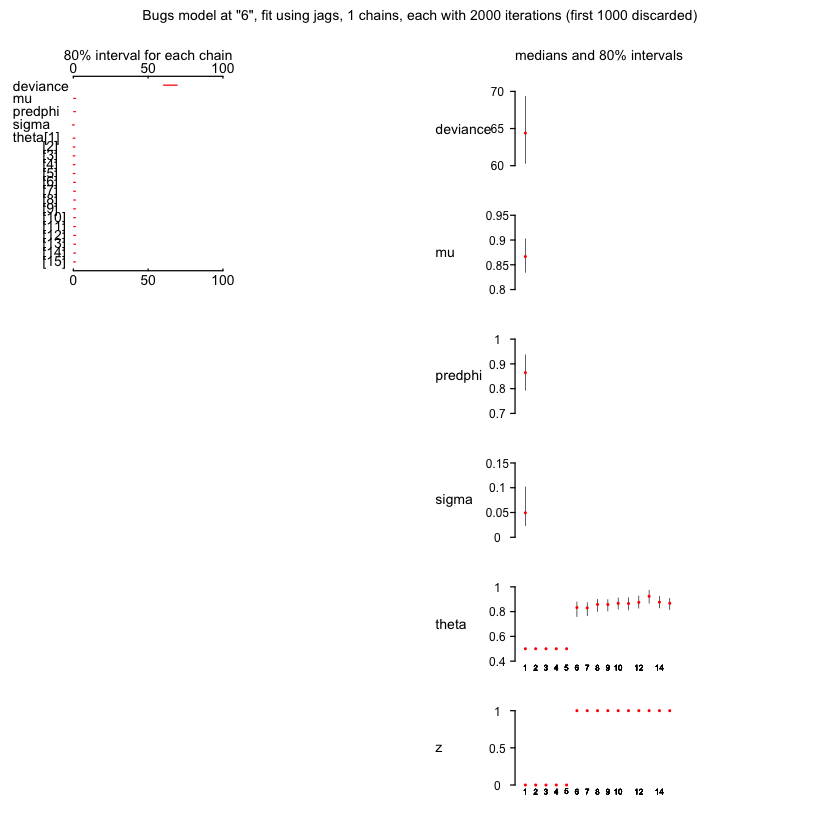

In [95]:
plot(samples)

### Stan code

In [96]:
model <- "
// Exam Scores With Individual Differences
data { 
  int<lower=1> p;
  int<lower=0> k[p];
  int<lower=1> n;
}
transformed data {
  real psi;

  // First Group Guesses
  psi <- .5;
}
parameters {
  vector<lower=0,upper=1>[p] phi;
  real<lower=.5,upper=1> mu;  // Second Group Mean
  real<lower=0> lambda;
  real<lower=0,upper=1> predphi;
} 
transformed parameters {
  vector[2] lp_parts[p];
  real<lower=0> sigma;

  // Second Group Standard Deviation
  sigma <- inv_sqrt(lambda);
  
  // Data Follow Binomial With Rate Given By Each Person's Group Assignment
  // Each Person Belongs To One Of Two Latent Groups
  for (i in 1:p) {
    lp_parts[i, 1] <- log(.5) + binomial_log(k[i], n, phi[i]);
    lp_parts[i, 2] <- log(.5) + binomial_log(k[i], n, psi); 
  }
}
model {
  // Second Group Precision
  lambda ~ gamma(.001, .001);
  // Posterior Predictive For Second Group
  predphi ~ normal(mu, sigma)T[0,1];
  // Second Group Drawn From A Censored Gaussian Distribution
  for (i in 1:p)
    phi[i] ~ normal(mu, sigma)T[0,1];
  
  for (i in 1:p)  
    increment_log_prob(log_sum_exp(lp_parts[i]));
}
generated quantities {
  int<lower=0,upper=1> z[p];
  vector<lower=0,upper=1>[p] theta;

  for (i in 1:p) {
    vector[2] prob;
    prob <- softmax(lp_parts[i]);
    z[i] <- bernoulli_rng(prob[1]);
    theta[i] <- (z[i] == 0) * psi + (z[i] == 1) * phi[i];
  }
}"

In [97]:
k <- c(21, 17, 21, 18, 22, 31, 31, 34, 34, 35, 35, 36, 39, 36, 35)
p <- length(k)  # number of people
n <- 40  # number of questions

In [98]:
data <- list(p=p, k=k, n=n) # to be passed on to Stan

In [99]:
myinits <- list(
  list(phi=runif(p, .5, 1), mu=.75, lambda=1, predphi=.75))

In [100]:
# parameters to be monitored: 
parameters <- c("predphi", "theta", "z", "mu", "sigma")

In [101]:
# The following command calls Stan with specific options.
# For a detailed description type "?rstan".
samples <- stan(model_code=model,   
                data=data, 
                init=myinits,  # If not specified, gives random inits
                pars=parameters,
                iter=20000, 
                chains=1, 
                thin=1,
                # warmup = 100,  # Stands for burn-in; Default = iter/2
                # seed = 123  # Setting seed; Default is random seed
)
# Now the values for the monitored parameters are in the "samples" object, 
# ready for inspection.


TRANSLATING MODEL 'model' FROM Stan CODE TO C++ CODE NOW.
COMPILING THE C++ CODE FOR MODEL 'model' NOW.
In file included from file3791a3e1763.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:17:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev.hpp:5:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev/chainable.hpp:87:17: warning: 'static' function 'set_zero_all_adjoints' declared in header file should be declared 'static inline' [-Wunneeded-internal-declaration]
    static void set_zero_all_adjoints() {
                ^
In file included from file3791a3e1763.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:21:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/

In [102]:
print(samples, digits=3)

Inference for Stan model: model.
1 chains, each with iter=20000; warmup=10000; thin=1; 
post-warmup draws per chain=10000, total post-warmup draws=10000.

             mean se_mean    sd    2.5%     25%     50%     75%   97.5% n_eff
predphi     0.860   0.001 0.068   0.709   0.823   0.863   0.903   0.981  4950
theta[1]    0.501   0.000 0.011   0.500   0.500   0.500   0.500   0.500  9898
theta[2]    0.500   0.000 0.005   0.500   0.500   0.500   0.500   0.500 10000
theta[3]    0.501   0.000 0.014   0.500   0.500   0.500   0.500   0.500  8757
theta[4]    0.500   0.000 0.005   0.500   0.500   0.500   0.500   0.500  9832
theta[5]    0.502   0.000 0.020   0.500   0.500   0.500   0.500   0.500  8859
theta[6]    0.817   0.001 0.050   0.706   0.793   0.824   0.851   0.894  3876
theta[7]    0.816   0.001 0.051   0.709   0.791   0.822   0.849   0.893  4632
theta[8]    0.852   0.001 0.040   0.765   0.827   0.855   0.881   0.923  4407
theta[9]    0.852   0.001 0.040   0.763   0.828   0.855   0.880  

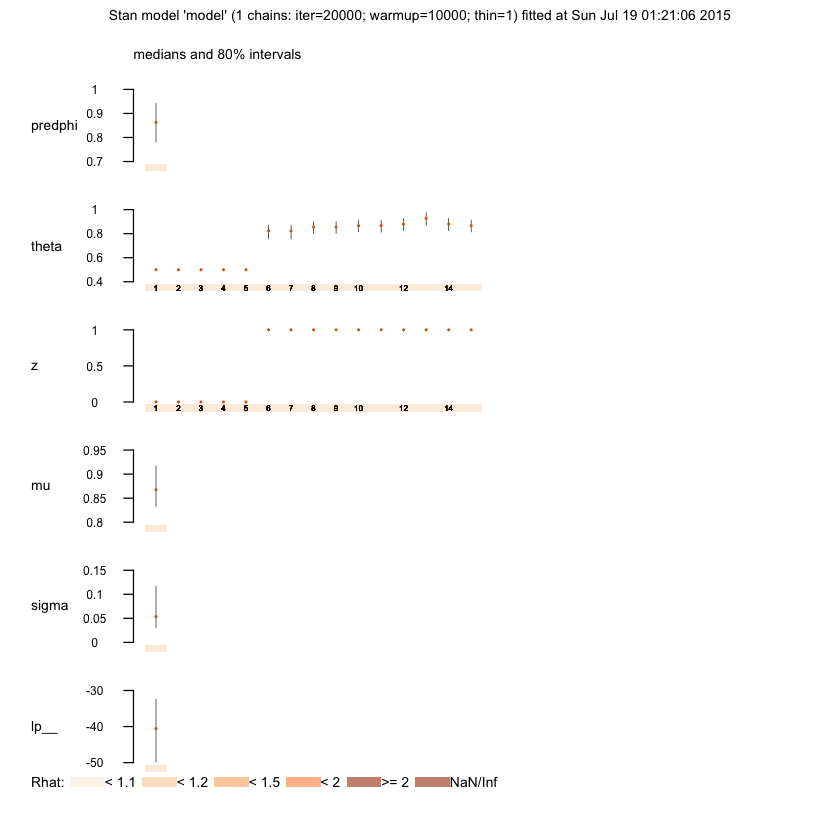

In [103]:
plot(samples)

# 6.3 Twenty questions

<img src="figures/tbl6.1.png" width=600 />

<img src="figures/fig6.3.png" width=600 />

### JAGS code

In [59]:
# Twenty Questions
s = "
model{
  # Correctness Of Each Answer Is Bernoulli Trial
  for (i in 1:np){
    for (j in 1:nq){
      k[i,j] ~ dbern(theta[i,j])
    }
  }
  # Probability Correct Is Product Of Question By Person Rates
  for (i in 1:np){
    for (j in 1:nq){
      theta[i,j] <- p[i]*q[j]
    }
  }
  # Priors For People and Questions
  for (i in 1:np){
    p[i] ~ dbeta(1,1)
  }
  for (j in 1:nq){
    q[j] ~ dbeta(1,1)
  }
}
"

In [65]:
# Twenty Questions (NA)
s_NA = "
model{
  # Correctness Of Each Answer Is Bernoulli Trial
  for (i in 1:np){
    for (j in 1:nq){
      k[i,j] ~ dbern(theta[i,j])
    }
  }
  # Probability Correct Is Product Of Question By Person Rates
  for (i in 1:np){
    for (j in 1:nq){
      theta[i,j] <- p[i]*q[j]
    }
  }
  # Priors For People and Questions
  for (i in 1:np){
    p[i] ~ dbeta(1,1)
  }
  for (j in 1:nq){
    q[j] ~ dbeta(1,1)
  }
  NA.array[1] <- k[1,13]
  NA.array[2] <- k[8,5]
  NA.array[3] <- k[10,18]
}
"

In [60]:
dset <- 1

if (dset==1)
{
  k <- c(1,1,1,1,0,0,1,1,0,1,0,0,1,0,0,1,0,1,0,0,
        0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
        0,0,1,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,
        0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,
        1,0,1,1,0,1,1,1,0,1,0,0,1,0,0,0,0,1,0,0,
        1,1,0,1,0,0,0,1,0,1,0,1,1,0,0,1,0,1,0,0,
        0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,
        0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
        0,1,1,0,0,0,0,1,0,1,0,0,1,0,0,0,0,1,0,1,
        1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0)
}

if (dset==2)
{
  k <- c(1,1,1,1,0,0,1,1,0,1,0,0,NA,0,0,1,0,1,0,0,
        0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
        0,0,1,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,
        0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,
        1,0,1,1,0,1,1,1,0,1,0,0,1,0,0,0,0,1,0,0,
        1,1,0,1,0,0,0,1,0,1,0,1,1,0,0,1,0,1,0,0,
        0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,
        0,0,0,0,NA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
        0,1,1,0,0,0,0,1,0,1,0,0,1,0,0,0,0,1,0,1,
        1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,NA,0,0)
}

In [61]:
k <- matrix(k, nrow=10, byrow=T)

In [62]:
np <- nrow(k)
nq <- ncol(k)

In [63]:
data <- list("np","nq","k") # to be passed on to JAGS

In [64]:
myinits <- list(
  list(q = runif(nq), p = runif(np)))

In [67]:
if (dset==1)
{
# parameters to be monitored:
  parameters <- c("p", "q")

  # The following command calls JAGS with specific options.
  # For a detailed description see the R2jags documentation.
  samples <- jags(data, inits=myinits, parameters,
                  textConnection(s), n.chains=1, n.iter=10000, 
                  n.burnin=1, n.thin=1, DIC=T)
  # Now the values for the monitored parameters are in the "samples" object, 
  # ready for inspection.
}

if (dset==2)
{
# parameters to be monitored:
  parameters <- c("p", "q", "NA.array")

  # The following command calls JAGS with specific options.
  # For a detailed description the R2jags documentation.
  samples <- jags(data, inits=myinits, parameters,
                  textConnection(s_NA), n.chains=1, n.iter=10000, 
                  n.burnin=1, n.thin=1, DIC=T)
  # Now the values for the monitored parameters are in the "samples" object, 
  # ready for inspection.
}

Compiling model graph
   Resolving undeclared variables
   Allocating nodes
   Graph Size: 433

Initializing model



In [68]:
samples

Inference for Bugs model at "6", fit using jags,
 1 chains, each with 10000 iterations (first 1 discarded)
 n.sims = 9999 iterations saved
         mu.vect sd.vect    2.5%     25%     50%     75%   97.5%
p[1]       0.890   0.095   0.647   0.842   0.917   0.963   0.997
p[2]       0.275   0.139   0.063   0.171   0.256   0.358   0.600
p[3]       0.478   0.170   0.182   0.353   0.467   0.593   0.831
p[4]       0.357   0.150   0.110   0.245   0.340   0.455   0.688
p[5]       0.843   0.120   0.552   0.772   0.868   0.939   0.995
p[6]       0.823   0.127   0.527   0.744   0.847   0.924   0.992
p[7]       0.177   0.113   0.023   0.091   0.156   0.242   0.448
p[8]       0.090   0.086   0.002   0.026   0.065   0.128   0.318
p[9]       0.722   0.159   0.392   0.611   0.734   0.847   0.979
p[10]      0.479   0.170   0.181   0.354   0.471   0.594   0.836
q[1]       0.731   0.177   0.345   0.614   0.753   0.876   0.988
q[2]       0.698   0.182   0.313   0.569   0.714   0.845   0.978
q[3]       0.768

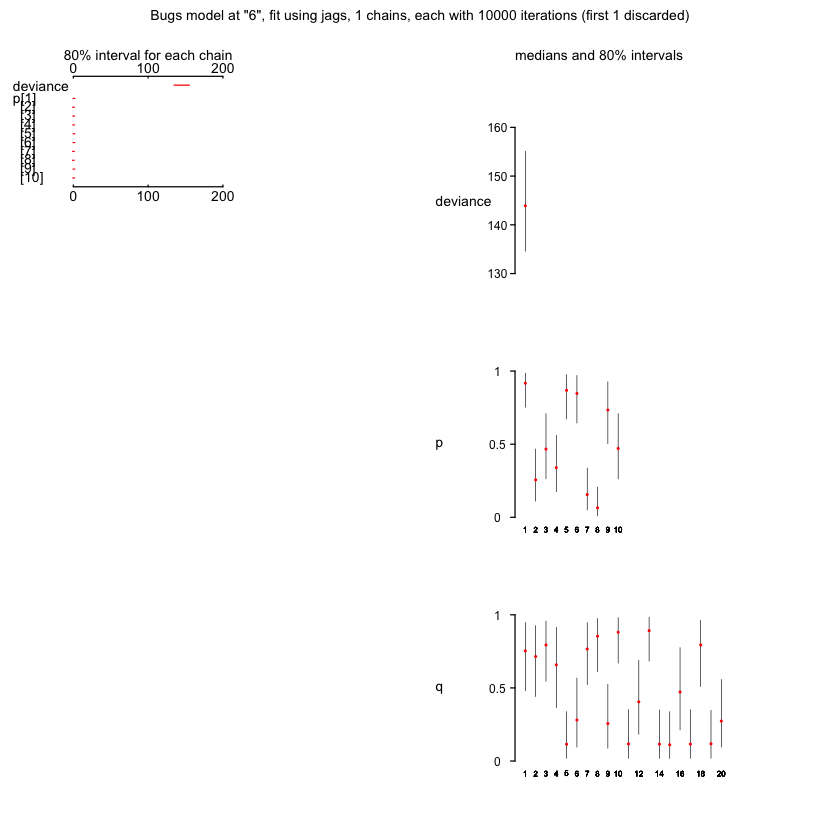

In [69]:
plot(samples)

# When you use WinBUGS and you want to sample the missing data, you cannot 
# just return "k" to R, as you can with Matlab. Most likely, the reason is 
# that "k" is a matrix, and, say, k[1,13] is a single number. WinBUGS will 
# sample k[1,13] when it contains "NA", but R will not accept a sequence of 
# samples for the cell k[1,13]. This means the following:
# 1. Using R2WinBUGS, you can tell WinBUGS to monitor and return "k". 
# When you set "debug=T", you can inspect the results, but, when you return
# to R, WinBUGS is unable to pass on its results.
# 2. One clumsy way around this problem is illustrated in the code
# TwentyQuestions_NA.txt. 
# Note that JAGS does not seem to have this problem and you can just
# examine "k".

### Stan code

In [71]:
#### Notes to Stan model #######################################################
## 1) There are two models in this script. The first one is not able to 
##    incorporate missing values as is required for exercise 6.3.2. The second
##    model is able to do that. Actually you can use the second model on both 
##    datasets - with or without NAs. 
## 2) Models with missing values can be tricky. It's important to know that
##    Stan treats variables either as know or unknown, therefore you have to
##    separate both parts first and then make it work somehow. Chapter on
##    Missing Data in Stan manual is useful.
################################################################################

In [72]:
model1 <- "
// Twenty Questions
data { 
  int<lower=0> np;  # rows
  int<lower=0> nq;  # columns
  int k[np,nq];
}
parameters {
  real<lower=0,upper=1> p[np];
  real<lower=0,upper=1> q[nq];
} 
transformed parameters {
  real<lower=0,upper=1> theta[np, nq];

  // Probability Correct Is Product Of Question By Person Rates
  for (i in 1:np)
    for (j in 1:nq)
      theta[i,j] <- p[i] * q[j];
}
model {
  // Priors For People and Questions
  p ~ beta(1, 1);
  q ~ beta(1, 1);
    
  // Correctness Of Each Answer Is Bernoulli Trial
  for (i in 1:np)
    for (j in 1:nq)
      k[i, j] ~ bernoulli(theta[i,j]);
}"

In [73]:
model2 <- "
# Twenty Questions
data { 
  int<lower=0> np;  // rows
  int<lower=0> nq;  // columns
  int k[np,nq];
  int k_na[np,nq];  // locating NAs in k
  int n_na;         // number of NAs
}
parameters {
  real<lower=0,upper=1> p[np];
  real<lower=0,upper=1> q[nq];
} 
transformed parameters {
  real<lower=0,upper=1> theta[np,nq];

  // Probability Correct Is Product Of Question By Person Rates
  for (i in 1:np)
    for (j in 1:nq)
      theta[i,j] <- p[i] * q[j];
}
model {
  // Priors For People and Questions
  p ~ beta(1, 1);
  q ~ beta(1, 1);
    
  // Correctness Of Each Answer Is Bernoulli Trial
  for (i in 1:np)
    for (j in 1:nq)
      if (k_na[i,j] == 0)     // If k[i,j] is not missing
        k[i,j] ~ bernoulli(theta[i,j]);
}
generated quantities {
  int na_array[n_na];
  int index;
  
  index <- 1;
  for (i in 1:np) {
    for (j in 1:nq) {   
      if (k_na[i,j] == 1) {   // If k[i,j] is missing
        na_array[index] <- bernoulli_rng(theta[i,j]);
        index <- index + 1;
      }
    }
  }
}"

In [75]:
dset <- 1  # Chooes dataset/model

if (dset == 1) {
  k <- c(1,1,1,1,0,0,1,1,0,1,0,0,1,0,0,1,0,1,0,0,
        0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
        0,0,1,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,
        0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,
        1,0,1,1,0,1,1,1,0,1,0,0,1,0,0,0,0,1,0,0,
        1,1,0,1,0,0,0,1,0,1,0,1,1,0,0,1,0,1,0,0,
        0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,
        0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
        0,1,1,0,0,0,0,1,0,1,0,0,1,0,0,0,0,1,0,1,
        1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0)
}

if (dset == 2) {
  k <- c(1,1,1,1,0,0,1,1,0,1,0,0,NA,0,0,1,0,1,0,0,
        0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
        0,0,1,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,
        0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,
        1,0,1,1,0,1,1,1,0,1,0,0,1,0,0,0,0,1,0,0,
        1,1,0,1,0,0,0,1,0,1,0,1,1,0,0,1,0,1,0,0,
        0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,
        0,0,0,0,NA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
        0,1,1,0,0,0,0,1,0,1,0,0,1,0,0,0,0,1,0,1,
        1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,NA,0,0)
}

In [76]:
k <- matrix(k, nrow=10, byrow=T)
np <- nrow(k)
nq <- ncol(k)

In [77]:
if (dset == 1) {
  model <- model1
  
  data <- list(k=k, np=np, nq=nq)  # to be passed on to Stan
  parameters <- c("p", "q")  # parameters to be monitored
  
} else if (dset == 2) {
  model <- model2
  k_na <- is.na(k) + 0  # Matrix locating missing values: 1 = missing
  n_na <- sum(k_na)  # number of missing values
  k[is.na(k)] <- 99  # some numeric value, since Stan doesn't eat NAs
  
  # to be passed on to Stan:
  data <- list(k=k, np=np, nq=nq, k_na=k_na, n_na=n_na)  
  parameters <- c("p", "q", "na_array")  # parameters to be monitored   
}

In [78]:
myinits <- list(
  list(q=runif(nq), p=runif(np)))

# The following command calls Stan with specific options.
# For a detailed description type "?rstan".
samples <- stan(model_code=model,   
                data=data, 
                init=myinits,  # If not specified, gives random inits
                pars=parameters,
                iter=10000, 
                chains=1, 
                thin=1,
                # warmup = 100,  # Stands for burn-in; Default = iter/2
                # seed = 123  # Setting seed; Default is random seed
)
# Now the values for the monitored parameters are in the "samples" object, 
# ready for inspection.


TRANSLATING MODEL 'model' FROM Stan CODE TO C++ CODE NOW.
COMPILING THE C++ CODE FOR MODEL 'model' NOW.
In file included from file37946b52b6.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:17:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev.hpp:5:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev/chainable.hpp:87:17: warning: 'static' function 'set_zero_all_adjoints' declared in header file should be declared 'static inline' [-Wunneeded-internal-declaration]
    static void set_zero_all_adjoints() {
                ^
In file included from file37946b52b6.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:21:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/in

In [79]:
print(samples, digits=3)

Inference for Stan model: model.
1 chains, each with iter=10000; warmup=5000; thin=1; 
post-warmup draws per chain=5000, total post-warmup draws=5000.

          mean se_mean    sd     2.5%      25%      50%      75%    97.5% n_eff
p[1]     0.890   0.001 0.094    0.655    0.841    0.915    0.963    0.996  5000
p[2]     0.275   0.002 0.141    0.064    0.169    0.252    0.361    0.605  4115
p[3]     0.478   0.003 0.171    0.183    0.349    0.468    0.596    0.836  3445
p[4]     0.353   0.002 0.150    0.109    0.243    0.336    0.447    0.683  3931
p[5]     0.847   0.002 0.118    0.567    0.776    0.872    0.941    0.995  5000
p[6]     0.821   0.002 0.124    0.540    0.745    0.842    0.921    0.990  5000
p[7]     0.173   0.002 0.110    0.024    0.088    0.154    0.230    0.452  4705
p[8]     0.093   0.001 0.086    0.003    0.030    0.068    0.130    0.320  5000
p[9]     0.721   0.002 0.158    0.398    0.608    0.732    0.844    0.979  5000
p[10]    0.478   0.003 0.174    0.179    0.351  

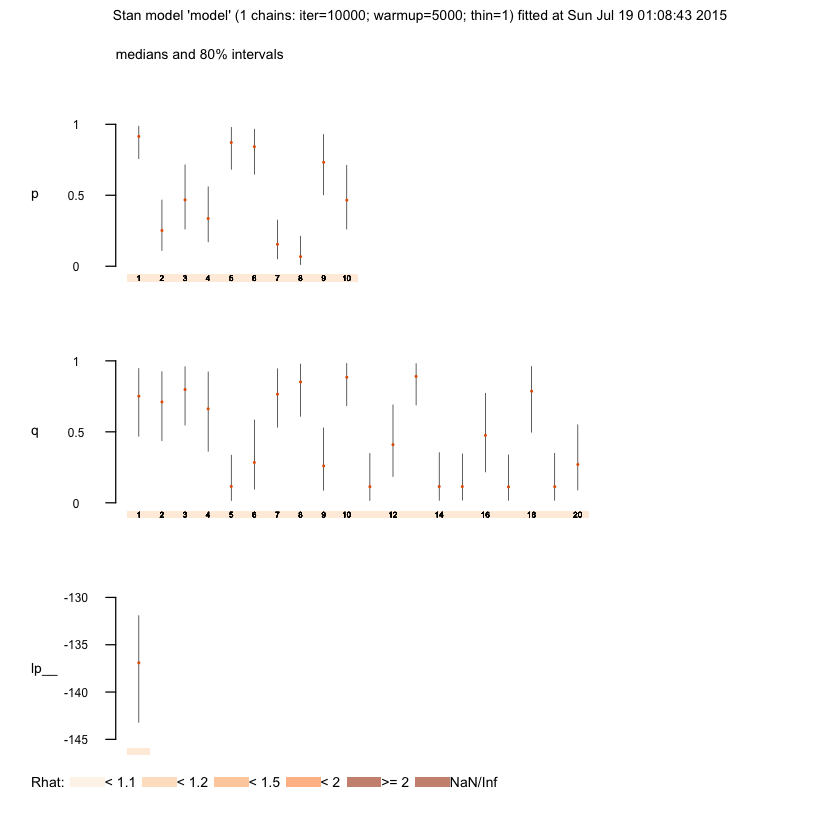

In [80]:
plot(samples)

#### Exercise 6.3.2 
Now suppose that three of the answers were not recorded, for what- ever reason. Our new data set, with missing data, now takes the form shown in Table 6.2. Bayesian inference will automatically make predictions about these missing values (i.e., “fill in the blanks”) by using the same probabilis- tic model that generated the observed data. Missing data are entered as nan (“not a number”) in Matlab, and NA (“not available”) in R or WinBUGS. Including the variable k as one to monitor when sampling will then provide posterior values for the missing values. That is, it provides information about the relative likelihood of the missing values being each of the possible alter- natives, using the statistical model and the available data. Look through the Matlab or R code to see how all of this is implemented in the second data set. Run the code, and interpret the posterior distributions for the three missing values. Are they reasonable inferences?

<img src="figures/tbl6.2.png" width=600 />

# 6.4 The two-country quiz

<img src="figures/fig6.4.png" width=600 />

<img src="figures/tbl6.3.png" width=600 />

### JAGS code

In [112]:
# The Two Country Quiz
s <- "
model{
  # Probability of Answering Correctly
  alpha ~ dunif(0,1)    # Match
  beta ~ dunif(0,alpha) # Mismatch   
  # Group Membership For People and Questions
  for (i in 1:nx){
    x[i] ~ dbern(0.5)
    x1[i] <- x[i]+1
  }
  for (j in 1:nz){
    z[j] ~ dbern(0.5)
    z1[j] <- z[j]+1
  }   
  # Probability Correct For Each Person-Question Combination By Groups
  for (i in 1:nx){
    for (j in 1:nz){
      theta[i,j,1,1] <- alpha
      theta[i,j,1,2] <- beta
      theta[i,j,2,1] <- beta
      theta[i,j,2,2] <- alpha
    }
  }   
  # Data Are Bernoulli By Rate
  for (i in 1:nx){
    for (j in 1:nz){
      k[i,j] ~ dbern(theta[i,j,x1[i],z1[j]])
    }
  }   
}
"

In [113]:
s_NA1 <- ""

In [114]:
s_NA2 <- ""

In [115]:
dset <- 1

if (dset==1)
{
k <- c(1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      0,1,1,0,0,1,0,0,
      0,1,1,0,0,1,1,0,
      1,0,0,1,1,0,0,1,
      0,0,0,1,1,0,0,1,
      0,1,0,0,0,1,1,0,
      0,1,1,1,0,1,1,0)
k <- matrix(k, nrow=8, byrow=T)
}

if (dset==2)
{
k <- c(1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      0,1,1,0,0,1,0,0,
      0,1,1,0,0,1,1,0,
      1,0,0,1,1,0,0,1,
      0,0,0,1,1,0,0,1,
      0,1,0,0,0,1,1,0,
      0,1,1,1,0,1,1,0,
      1,0,0,1,NA,NA,NA,NA,
      0,NA,NA,NA,NA,NA,NA,NA,
      NA,NA,NA,NA,NA,NA,NA,NA)
k <- matrix(k, nrow=11, byrow=T)
}

if (dset==3)
{
k <- c(1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      1,0,0,1,1,0,0,1,
      0,1,1,0,0,1,0,0,
      0,1,1,0,0,1,1,0,
      1,0,0,1,1,0,0,1,
      0,0,0,1,1,0,0,1,
      0,1,0,0,0,1,1,0,
      0,1,1,1,0,1,1,0,
      1,0,0,1,NA,NA,NA,NA,
      0,NA,NA,NA,NA,NA,NA,NA,
      NA,NA,NA,NA,NA,NA,NA,NA)
k <- matrix(k, nrow=21, byrow=T)
}

In [116]:
nx <- nrow(k)
nz <- ncol(k)

In [117]:
data <- list("nx","nz","k") # to be passed on to JAGS

In [118]:
inits <- list(
  list(z = round(runif(nz)), x = round(runif(nx)), alpha=0.5, beta=0.5))

In [119]:
if (dset==1)
{
# parameters to be monitored:
  parameters <- c("z", "x", "alpha", "beta")

  # The following command calls JAGS with specific options.
  # For a detailed description see the R2jags documentation.
  samples <- jags(data, inits, parameters,
                  textConnection(s), n.chains=1, n.iter=2000, 
                  n.burnin=1000, n.thin=1, DIC=T)
  # Now the values for the monitored parameters are in the "samples" object, 
  # ready for inspection.
}

if (dset==2)
{
# parameters to be monitored:
  parameters <- c("z", "x", "alpha", "beta", "NA.LP1", "NA.LP2", "NA.LP3")

  # The following command calls JAGS with specific options.
  # For a detailed description the R2jags documentation.
  # model.file ="TwoCountryQuiz_NA1.txt"  
  samples <- jags(data, inits, parameters,
                  textConnection(s_NA1), n.chains=1, 
                  n.iter=2000, n.burnin=1000, n.thin=1, DIC=T)
  # Now the values for the monitored parameters are in the "samples" object, 
  # ready for inspection.
}

if (dset==3)
{
# parameters to be monitored:
  parameters <- c("z", "x", "alpha", "beta", "NA.LP1", "NA.LP2", "NA.LP3")

  # The following command calls JAGS with specific options.
  # For a detailed description the R2jags documentation.
  # model.file ="TwoCountryQuiz_NA2.txt"  
  samples <- jags(data, inits, parameters,
                  textConnection(s_NA2), n.chains=1, 
                  n.iter=2000, n.burnin=1000, n.thin=1, DIC=T)
  # Now the values for the monitored parameters are in the "samples" object, 
  # ready for inspection.
}

Compiling model graph
   Resolving undeclared variables
   Allocating nodes
   Graph Size: 167

Initializing model



In [120]:
samples

Inference for Bugs model at "4", fit using jags,
 1 chains, each with 2000 iterations (first 1000 discarded)
 n.sims = 1000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%
alpha      0.881   0.053  0.758  0.851  0.888  0.920  0.961
beta       0.059   0.038  0.008  0.029  0.051  0.080  0.151
x[1]       1.000   0.000  1.000  1.000  1.000  1.000  1.000
x[2]       1.000   0.000  1.000  1.000  1.000  1.000  1.000
x[3]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
x[4]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
x[5]       1.000   0.000  1.000  1.000  1.000  1.000  1.000
x[6]       1.000   0.000  1.000  1.000  1.000  1.000  1.000
x[7]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
x[8]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
z[1]       1.000   0.000  1.000  1.000  1.000  1.000  1.000
z[2]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
z[3]       0.000   0.000  0.000  0.000  0.000  0.000  0.000
z[4]       1.000   

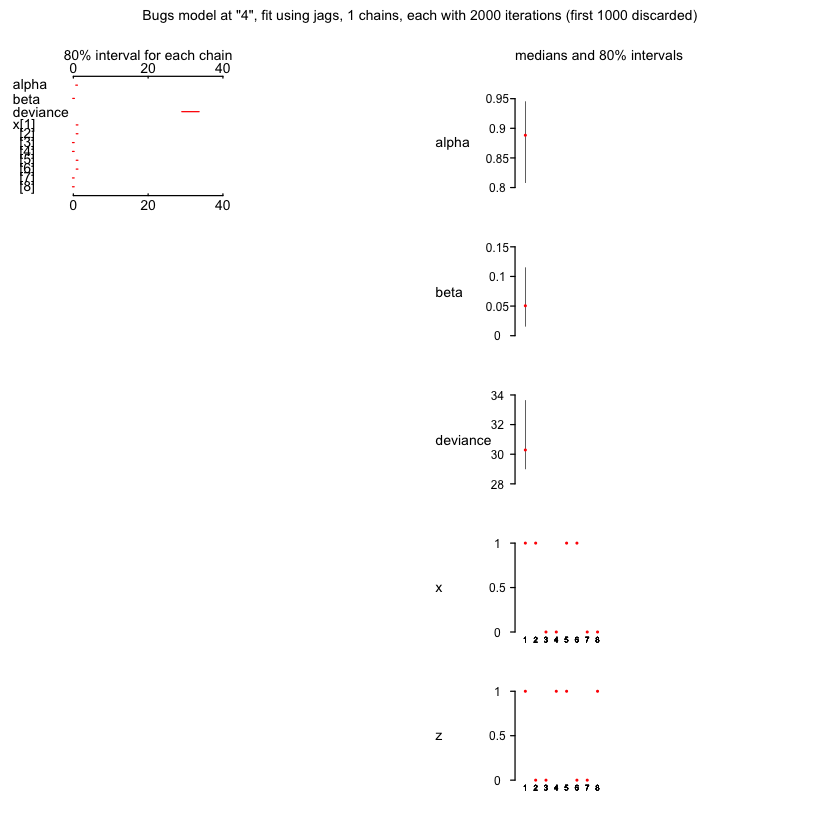

In [121]:
plot(samples)

### Stan code

In [122]:
# Unfortunately, this model is not implemented! Search "double mixture model" 
# on mailing list to find out why.
# If you have some suggestions about the model, let us know! 

#### Exercise 6.4.3 
Now suppose that three extra people enter the room late, and begin to take the quiz. One of them (Late Person 1) has answered the first four questions, the next (Late Person 2) has only answered the first question, and the final new person (Late Person 3) is still sharpening their pencil, and has not started the quiz. This situation can be represented as an updated data set, now with missing data, as in Table 6.4. Interpret the inferences the model makes about the nationality of the late people, and whether or not they will get the unfinished questions correct.

<img src="figures/tbl6.4.png" width=600 />

#### Exercise 6.4.4 
Finally, suppose that you are now given the correctness scores for a set of 10 new people, whose data were not previously available, but who form part of the same group of people we are studying. The updated data set is shown in Table 6.5. Interpret the inferences the model makes about the nationality of the new people. Revisit the inferences about the late people, and whether or not they will get the unfinished questions correct. Does the inference drawn by the model for the third late person match your intuition? There is a problem here. How could it be fixed?

<img src="figures/tbl6.5.png" width=600 />

# 6.5 Assessment of malingering

<img src="figures/fig6.5.png" width=600 />

### JAGS code

In [123]:
# Malingering
s <- "
model{
  # Each Person Belongs to One of Two Latent Groups
  for (i in 1:p){
    z[i] ~ dbern(0.5)
    z1[i] <- z[i]+1
  }
  # Bona Fide Group has Unknown Success Rate Above Chance
  psi[1] ~ dunif(0.5,1)
  # Malingering Group has Unknown Success Rate Below Bona Fide
  psi[2] ~ dunif(0,psi[1])
  # Data are Binomial with Group Rate for Each Person
  for (i in 1:p){
    theta[i] <- psi[z1[i]]
    k[i] ~ dbin(theta[i],n)
  }
}
"

In [124]:
k <- c(45,45,44,45,44,45,45,45,45,45,30,20,6,44,44,27,25,17,14,27,35,30)
p <- length(k) # number of people
n <- 45        # number of questions

In [125]:
data <- list("p", "k", "n") # to be passed on to JAGS

In [126]:
myinits <- list(
  list(psi = c(0.7,0.5), z = round(runif(p)))) # Initial group assignment

In [127]:
# parameters to be monitored:
parameters <- c("psi","z")

In [128]:
# The following command calls JAGS with specific options.
# For a detailed description see the R2jags documentation.
samples <- jags(data, inits=myinits, parameters,
                textConnection(s), n.chains=1, n.iter=2000, 
                n.burnin=1000, n.thin=1, DIC=T)

Compiling model graph
   Resolving undeclared variables
   Allocating nodes
   Graph Size: 95

Initializing model



In [129]:
samples

Inference for Bugs model at "6", fit using jags,
 1 chains, each with 2000 iterations (first 1000 discarded)
 n.sims = 1000 iterations saved
         mu.vect sd.vect    2.5%     25%     50%     75%   97.5%
psi[1]     0.991   0.004   0.980   0.988   0.991   0.994   0.997
psi[2]     0.513   0.023   0.467   0.496   0.513   0.529   0.558
z[1]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[2]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[3]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[4]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[5]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[6]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[7]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[8]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[9]       0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[10]      0.000   0.000   0.000   0.000   0.000   0.000   0.000
z[11]      1.0

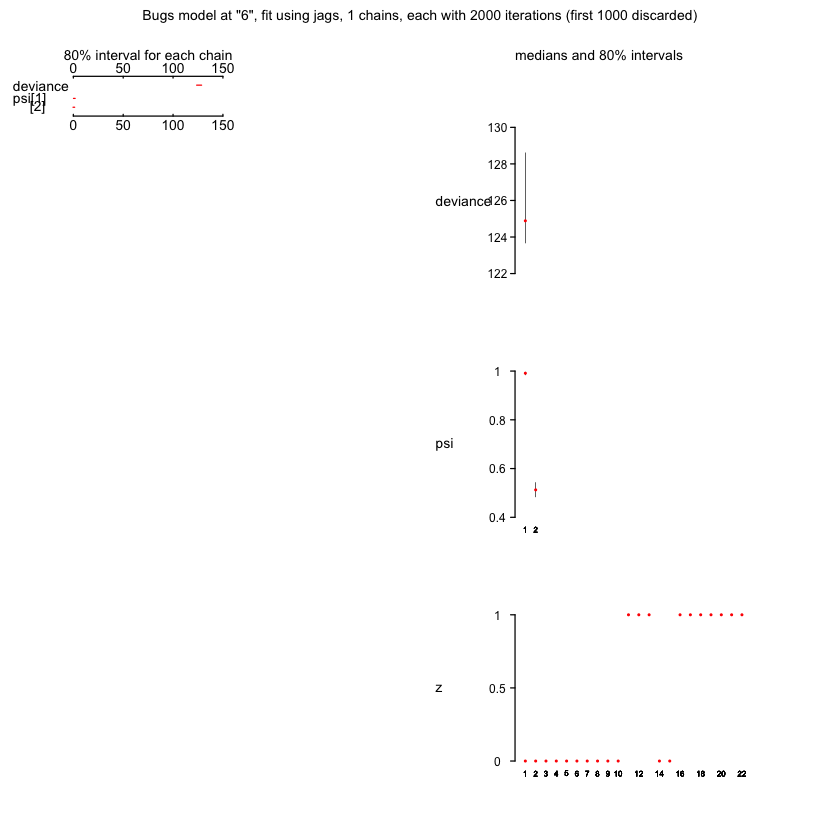

In [130]:
plot(samples)

### Stan code

In [132]:
model <- "
// Malingering
data { 
  int<lower=1> n;
  int<lower=1> p;
  int<lower=0,upper=n> k[p];
}
parameters {
  vector<lower=0,upper=1>[2] psi;
} 
transformed parameters {
  vector[2] lp_parts[p];

  for (i in 1:p) {
    lp_parts[i, 1] <- log(.5) + binomial_log(k[i], n, psi[1]);
    lp_parts[i, 2] <- log(.5) + binomial_log(k[i], n, psi[2]);
  } 
}
model {
  // Bona Fide Group has Unknown Success Rate Above Chance
  psi[1] ~ uniform(.5, 1);
  // Malingering Group has Unknown Success Rate Below Bona Fide
  psi[2] ~ uniform(0, psi[1]);

  for (i in 1:p)
    increment_log_prob(log_sum_exp(lp_parts[i]));    
}
generated quantities {
  int<lower=0,upper=1> z[p];
  
  for (i in 1:p) {
    vector[2] prob;
    prob <- softmax(lp_parts[i]);
    z[i] <- bernoulli_rng(prob[2]);
  }
}"

k <- c(45, 45, 44, 45, 44, 45, 45, 45, 45, 45, 30,
       20, 6, 44, 44, 27, 25, 17, 14, 27, 35, 30)
p <- length(k)  # number of people
n <- 45         # number of questions

data <- list(p=p, k=k, n=n)  # To be passed on to Stan

myinits <- list(
    list(psi=c(.7, .5)))

parameters <- c("psi","z")  # Parameters to be monitored

# The following command calls Stan with specific options.
# For a detailed description type "?rstan".
samples <- stan(model_code=model,   
                data=data, 
                init=myinits,  # If not specified, gives random inits
                pars=parameters,
                iter=2000, 
                chains=1, 
                thin=1,
                # warmup = 100,  # Stands for burn-in; Default = iter/2
                # seed = 123  # Setting seed; Default is random seed
)
# Now the values for the monitored parameters are in the "samples" object, 
# ready for inspection.

print(samples, digits=3)


TRANSLATING MODEL 'model' FROM Stan CODE TO C++ CODE NOW.
COMPILING THE C++ CODE FOR MODEL 'model' NOW.
In file included from file3797de71602.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:17:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev.hpp:5:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev/chainable.hpp:87:17: warning: 'static' function 'set_zero_all_adjoints' declared in header file should be declared 'static inline' [-Wunneeded-internal-declaration]
    static void set_zero_all_adjoints() {
                ^
In file included from file3797de71602.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:21:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/

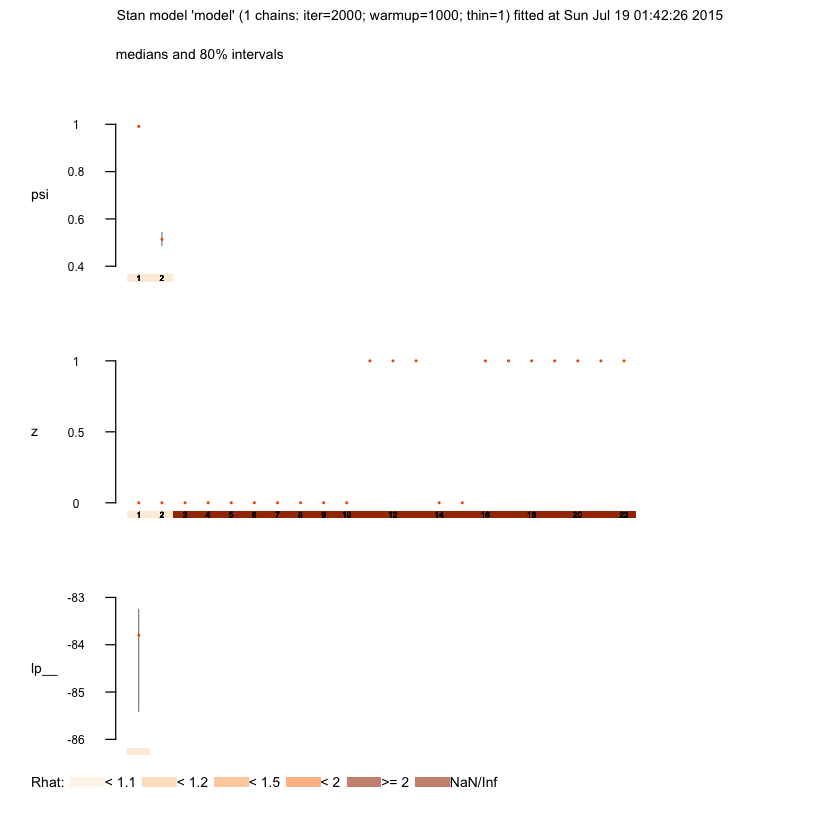

In [133]:
plot(samples)

# 6.6 Individual differences in malingering

<img src="figures/fig6.6.png" width=600 />

<img src="figures/fig6.7.png" width=600 />

### JAGS code

In [134]:
# Malingering, with Individual Differences
s <- "
model{
  # Each Person Belongs to One of Two Latent Groups
  for (i in 1:p){
    z[i] ~ dbern(phi) # phi is the Base Rate
    z1[i] <- z[i]+1
  }
  # Relatively Uninformative Prior on Base Rate
  phi ~ dbeta(5,5) 
  # Data are Binomial with Rate Given by 
  # Each Person's Group Assignment
  for (i in 1:p){
    k[i] ~ dbin(theta[i,z1[i]],n)
    theta[i,1] ~ dbeta(alpha[1],beta[1])
    theta[i,2] ~ dbeta(alpha[2],beta[2])
  }
  # Transformation to Group Mean and Precision
  alpha[1] <- mubon * lambdabon
  beta[1] <- lambdabon * (1-mubon)
  # Additivity on Logit Scale
  logit(mumal) <- logit(mubon) - mudiff
  alpha[2] <- mumal * lambdamal
  beta[2]  <- lambdamal * (1-mumal)
  # Priors
  mubon ~ dbeta(1,1)
  mudiff ~ dnorm(0,0.5)T(0,) # Constrained to be Positive
  lambdabon ~ dunif(40,800)
  lambdamal ~ dunif(4,100)
}
"

In [135]:
k <- c(45,45,44,45,44,45,45,45,45,45,30,20,6,44,44,27,25,17,14,27,35,30)
p <- length(k) # number of people
n <- 45        # number of questions

data <- list("p", "k", "n") # to be passed on to JAGS
myinits <- list(
  list(z = round(runif(p)), mudiff=0.2),
  list(z = round(runif(p)), mudiff=0.3),
  list(z = round(runif(p)), mudiff=0.4)) 

# parameters to be monitored:
parameters <- c("theta","z","mubon","lambdabon",
               "mumal","lambdamal","mudiff","phi")

# The following command calls JAGS with specific options.
# For a detailed description see the R2jags documentation.
samples <- jags(data, inits=myinits, parameters,
                textConnection(s), n.chains=3, n.iter=10000, 
                n.burnin=1000, n.thin=1, DIC=T)

Compiling model graph
   Resolving undeclared variables
   Allocating nodes
   Graph Size: 156

Initializing model



In [138]:
samples

Inference for Bugs model at "4", fit using jags,
 3 chains, each with 10000 iterations (first 1000 discarded)
 n.sims = 27000 iterations saved
            mu.vect sd.vect   2.5%     25%     50%     75%   97.5%  Rhat n.eff
lambdabon   430.459 219.873 58.330 242.783 436.679 622.219 782.243 1.004   690
lambdamal    10.007   5.198  4.290   6.403   8.686  12.130  23.269 1.001 12000
mubon         0.986   0.005  0.974   0.983   0.987   0.990   0.994 1.005   510
mudiff        4.175   0.458  3.308   3.871   4.156   4.468   5.107 1.005   440
mumal         0.539   0.059  0.429   0.500   0.537   0.577   0.662 1.002  2400
phi           0.471   0.087  0.302   0.410   0.470   0.531   0.643 1.001 12000
theta[1,1]    0.988   0.007  0.971   0.984   0.989   0.993   0.999 1.002  1300
theta[2,1]    0.988   0.007  0.971   0.984   0.989   0.993   0.999 1.002  1700
theta[3,1]    0.985   0.008  0.966   0.981   0.987   0.991   0.997 1.003  1100
theta[4,1]    0.988   0.007  0.971   0.984   0.989   0.993   0.999 

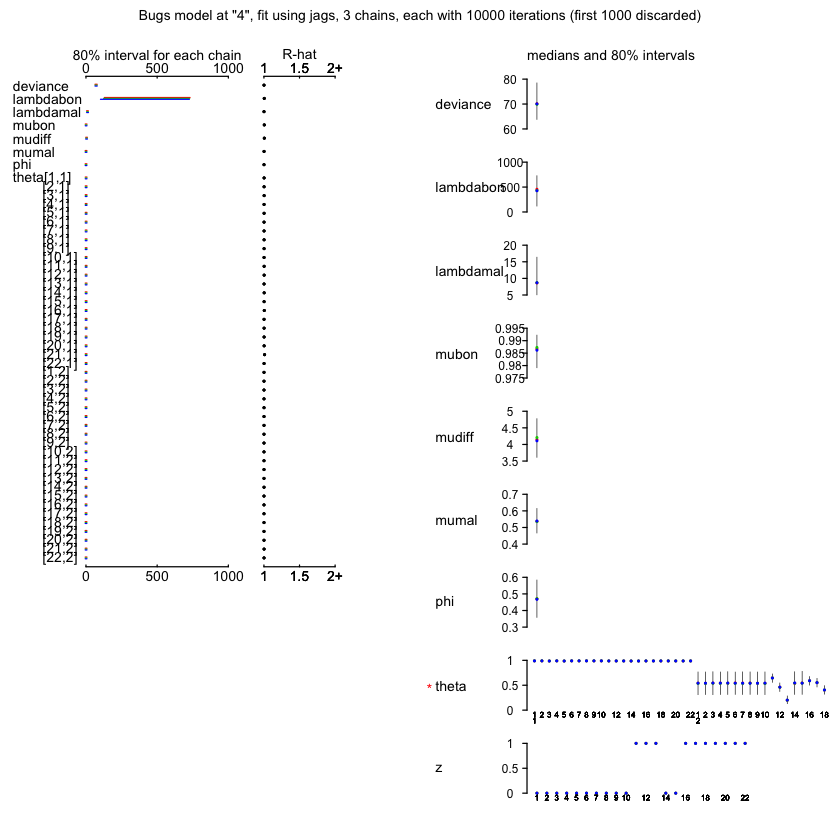

In [139]:
plot(samples)

### Stan code

In [140]:
model <- "
// Malingering, with Individual Differences
data { 
  int<lower=1> n;
  int<lower=1> p;
  int<lower=0,upper=n> k[p];
}
parameters {
  real<lower=0,upper=1> phi;
  real<lower=0,upper=1> mubon;
  real<lower=0> mudiff;
  real<lower=40,upper=800> lambdabon;
  real<lower=4,upper=100> lambdamal;
  matrix<lower=0,upper=1>[p,2] theta;
} 
transformed parameters {
  vector[2] lp_parts[p];
  vector<lower=0>[2] alpha;
  vector<lower=0>[2] beta;
  real<lower=0,upper=1> mumal;
    
  // Additivity on Logit Scale
  mumal <- inv_logit(logit(mubon) - mudiff);
  
  // Transformation to Group Mean and Precision
  alpha[1] <- mubon * lambdabon;
  beta[1] <- lambdabon * (1 - mubon);
  alpha[2] <- mumal * lambdamal;
  beta[2] <- lambdamal * (1 - mumal);
    
  // Data are Binomial with Rate Given by 
  // Each Person’s Group Assignment
  for (i in 1:p) {
    lp_parts[i,1] <- log1m(phi) + binomial_log(k[i], n, theta[i,1]);
    lp_parts[i,2] <- log(phi) + binomial_log(k[i], n, theta[i,2]);
  } 
}
model {
  // Priors
  mubon ~ beta(1, 1);  // can be removed
  mudiff ~ normal(0, 1 / sqrt(.5))T[0,];  // Constrained to be Positive
  // Relatively Uninformative Prior on Base Rate
  phi ~ beta(5, 5);
  
  for (i in 1:p)
    theta[i] ~ beta(alpha, beta);
    
  for (i in 1:p)
    increment_log_prob(log_sum_exp(lp_parts[i]));   
}
generated quantities {
  int<lower=0,upper=1> z[p];
    
  for (i in 1:p) {
    vector[2] prob;
    prob <- softmax(lp_parts[i]);
    // Each Person Belongs to One of Two Latent Groups
    z[i] <- bernoulli_rng(prob[2]);
  }
}"

k <- c(45, 45, 44, 45, 44, 45, 45, 45, 45, 45, 30,
       20, 6, 44, 44, 27, 25, 17, 14, 27, 35, 30)
p <- length(k) # number of people
n <- 45        # number of questions

data <- list(p=p, k=k, n=n) # To be passed on to Stan

myinits <- list(
    list(phi=.5, mubon=.5, mudiff=1, lambdabon=400, lambdamal=50,
         theta=matrix(rep(.5, p * 2), p, 2)))

# Parameters to be monitored
parameters <- c("mubon", "lambdabon", "mumal", "lambdamal", "mudiff", 
                "phi", "theta", "z")  

# The following command calls Stan with specific options.
# For a detailed description type "?rstan".
samples <- stan(model_code=model,   
                data=data, 
                init=myinits,  # If not specified, gives random inits
                pars=parameters,
                iter=3000, 
                chains=1, 
                thin=1,
                # warmup = 100,  # Stands for burn-in; Default = iter/2
                # seed = 123  # Setting seed; Default is random seed
)
# Now the values for the monitored parameters are in the "samples" object, 
# ready for inspection.

print(samples, digits=3)


TRANSLATING MODEL 'model' FROM Stan CODE TO C++ CODE NOW.
COMPILING THE C++ CODE FOR MODEL 'model' NOW.
In file included from file379465f30d6.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:17:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev.hpp:5:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev/chainable.hpp:87:17: warning: 'static' function 'set_zero_all_adjoints' declared in header file should be declared 'static inline' [-Wunneeded-internal-declaration]
    static void set_zero_all_adjoints() {
                ^
In file included from file379465f30d6.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:21:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/

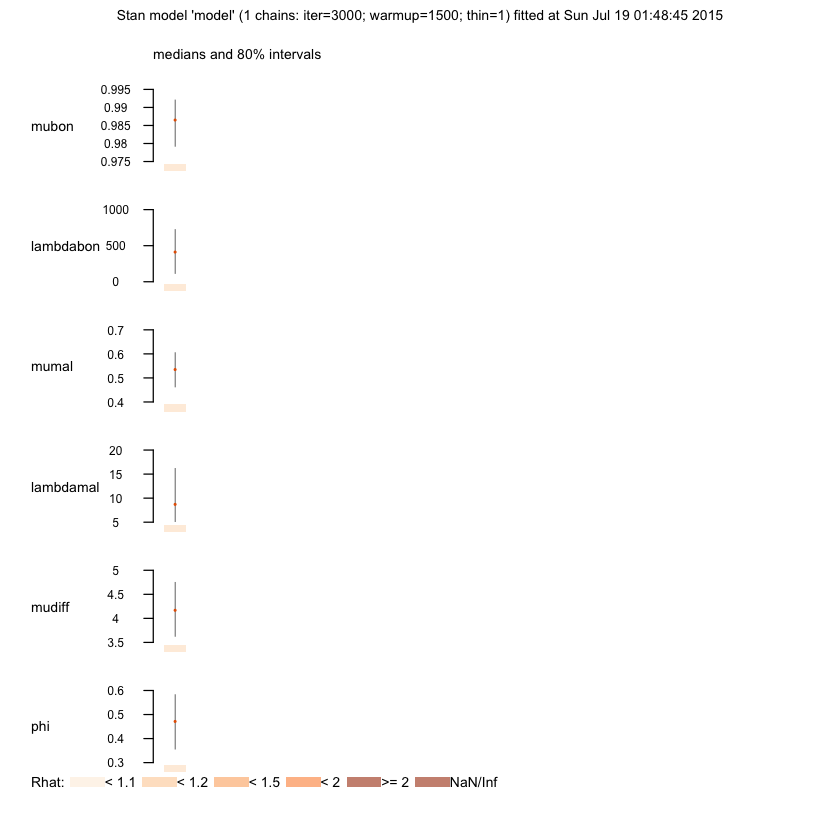

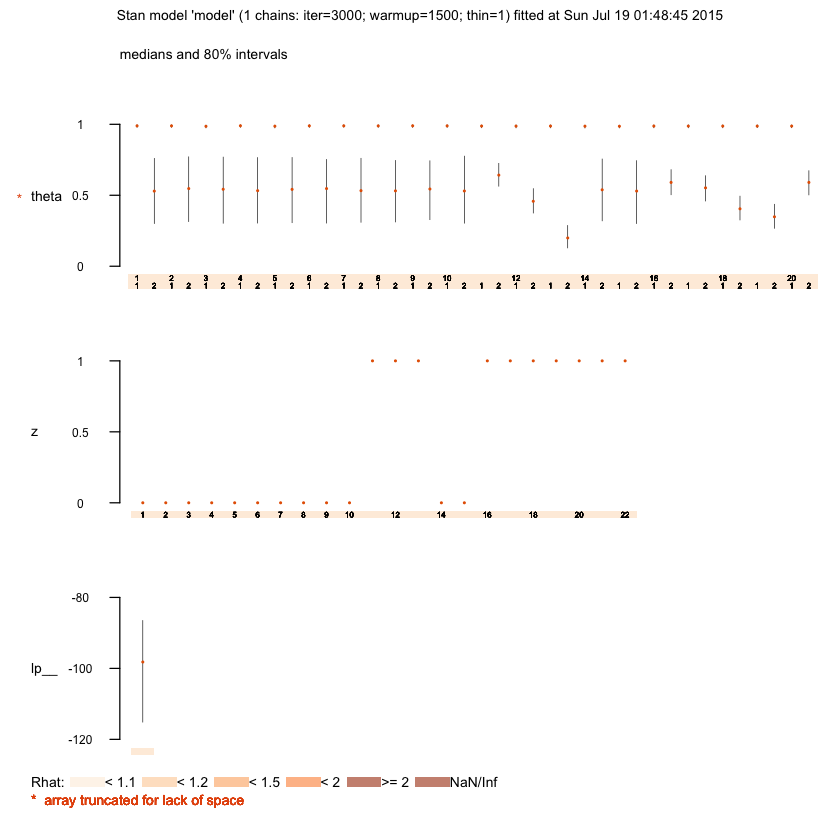

In [141]:
plot(samples)

# 6.7 Alzheimer’s recall test cheating

<img src="figures/fig6.8.png" width=600 />

<img src="figures/fig6.9.png" width=600 />

<img src="figures/fig6.10.png" width=600 />

### JAGS code

In [157]:
# Cheating Latent Mixture Model
s <- "
model{
  # Each Person Belongs to One of Two Latent Groups
  for (i in 1:p){
     z[i] ~ dbern(phi) # phi is the Base Rate
     z1[i] <- z[i]+1
  }
  # Relatively Uninformative Prior on Base Rate
  phi ~ dbeta(5,5) 
  # Data are Binomial with Rate Given by 
  # Each Person뭩 Group Assignment
  for (i in 1:p){
    k[i] ~ dbin(theta[i,z1[i]],n)
    thetatmp[i,1] ~ dbeta(alpha[1],beta[1])
    theta[i,1] <- max(.01,min(.99,thetatmp[i,1]))
    thetatmp[i,2] ~ dbeta(alpha[2],beta[2])
    theta[i,2] <- max(.01,min(.99,thetatmp[i,2]))
  }
  # Transformation to Group Mean and Precision
  alpha[1] <- mubon * lambdabon
  beta[1] <- lambdabon * (1-mubon)
  # Additivity on Logit Scale
  logit(muche) <- logit(mubon) + mudiff # Note the +
  alpha[2] <- muche * lambdache
  beta[2] <- lambdache * (1-muche)
  # Priors
  mubon ~ dbeta(1,1)
  mudiff ~ dnorm(0,0.5)T(0,) # Constrained to be Positive
  lambdabon ~ dunif(5,50)
  lambdache ~ dunif(5,50)
  # Correct Count
  for (i in 1:p){
    pct[i] <- equals(z[i],truth[i])
  }
  pc <- sum(pct[1:p])
}
"

In [158]:
cheat.dat <- read.table("cheat.csv",header=F,sep=",")

In [159]:
cheatt.dat <- read.table("cheatt.csv",header=F,sep="")

In [160]:
truth <- cheatt.dat$V1 #truth = 1 if cheater
truth

[1] 1 0 1 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1
 [38] 0 0 1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 0 1 0
 [75] 1 0 1 0 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0
[112] 1 0 1 0 1 0 1

In [161]:
k <- apply(cheat.dat,1,sum) # total correct per participant
p <- length(k) # number of people
n <- 40        # total trials

data <- list("p", "k", "n", "truth") # to be passed on to JAGS
myinits <- list(
  list(z = round(runif(p)), mudiff=0.1, phi=0.5, mubon=0.5, lambdabon=30, lambdache=25),
  list(z = round(runif(p)), mudiff=0.15, phi=0.5, mubon=0.5, lambdabon=25, lambdache=30)
  ) 

#myinits <- list(
#  list(z = round(runif(p)), mudiff=0.1, phi=0.5, mubon=0.5, lambdabon=10, lambdache=10),
#  list(z = round(runif(p)), mudiff=0.2, phi=0.5, mubon=0.5, lambdabon=10, lambdache=10)
#  ) 

# parameters to be monitored:
parameters <- c("theta","z","mubon","lambdabon",
               "muche","lambdache","mudiff","phi","alpha","beta","pc")

set.seed(3) # some chains result in "undefined real result -- see box & exercise"

# The following command calls JAGS with specific options.
# For a detailed description see the R2jags documentation.
samples = jags(data, inits=myinits, parameters,
               textConnection(s), n.chains=2, n.iter=6000, 
               n.burnin=3000, n.thin=1, DIC=T)

Compiling model graph
   Resolving undeclared variables
   Allocating nodes
   Graph Size: 1441

Initializing model


Deleting model



ERROR: Error: Error in node lambdache
Slicer stuck at value with infinite density




In [156]:
samples$summary

NULL

In [162]:
pc <- samples$BUGSoutput$sims.list$pc/p #to get proportion correct
mean(pc)

[1] 0.737137

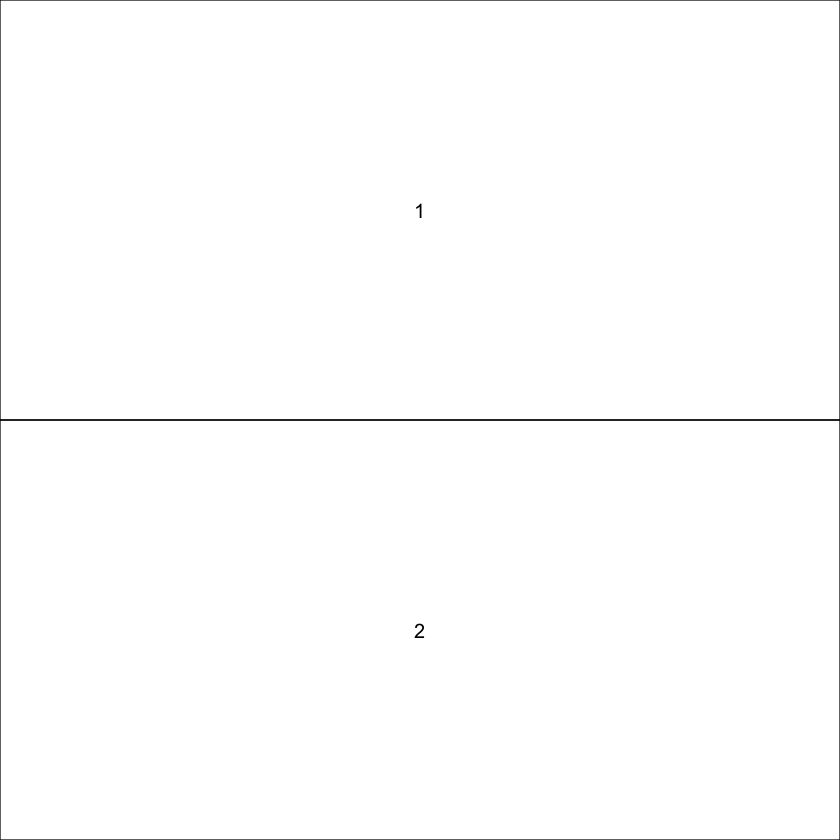

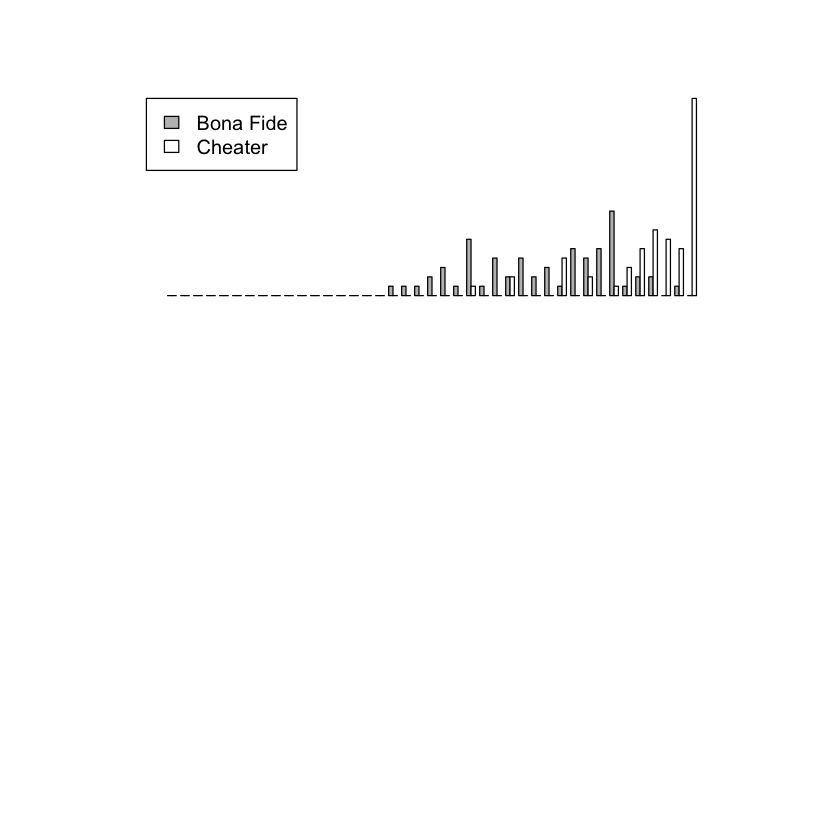

In [164]:
# plot 6.9
#make the two panel plot:
#windows(width=8,height=6) #this command works only under Windows!
layout(matrix(c(1,2),2,1))
layout.show(2)
par(cex.main = 1.5, mar = c(5, 6, 4, 5) + 0.1, mgp = c(3.5, 1, 0), cex.lab = 1.5,
    font.lab = 2, cex.axis = 1.3, bty = "n", las=1)
bins <- c(-1:n)+.5
bonafide <- hist(k[truth==0], breaks=bins, plot=F)$counts
cheat    <- hist(k[truth==1], breaks=bins, plot=F)$counts

counts <- rbind(bonafide, cheat)
barplot(counts, main=" ", xlab=" ", col=c("grey","white"),
  legend.text = c("Bona Fide","Cheater"), args.legend = list(x="topleft"),
  beside=TRUE, axes=F)

# bottom panel:
par(cex.main = 1.5, mar = c(5, 6, 4, 5) + 0.1, mgp = c(3.5, 1, 0), cex.lab = 1.5,
    font.lab = 2, cex.axis = 1.3, bty = "n", las=1)
pc.line <- array()
for (i in 1:41)
{
  pc.line[i] <- mean((k>=(i-1))==truth)
}

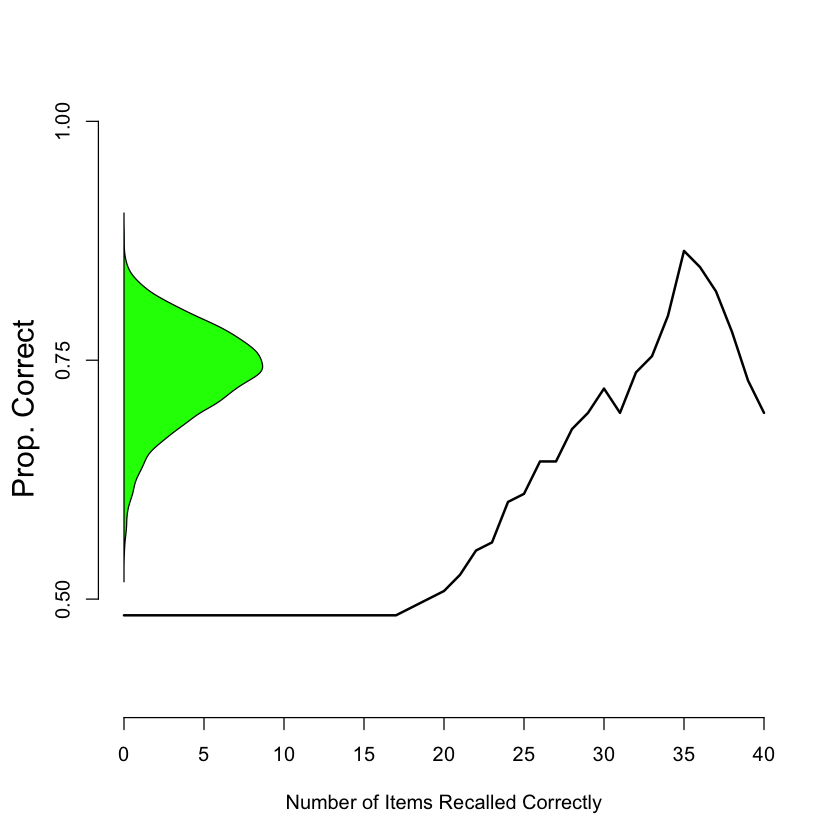

In [165]:
#dev.new() # so the plot below does not overwrite the plot above

plot(c(0:40), pc.line, type="l", lwd=2, xlim=c(0,40), ylim=c(0.4,1), 
     xlab="Number of Items Recalled Correctly", 
     ylab=" ", axes=F)
axis(1, at=c(0,seq(from=5,by=5,to=40)))
axis(2, at=c(.5,.75,1))
par(las=0)
mtext("Prop. Correct",side=2, line=2.5,cex=1.5)
# Now add the distribution:
pc.dens <- density(pc)
polygon(c(0,pc.dens$y,0,0), c(pc.dens$x[1]-.01,pc.dens$x,pc.dens$x[1]+.01,pc.dens$x[1]-.01), col="green")



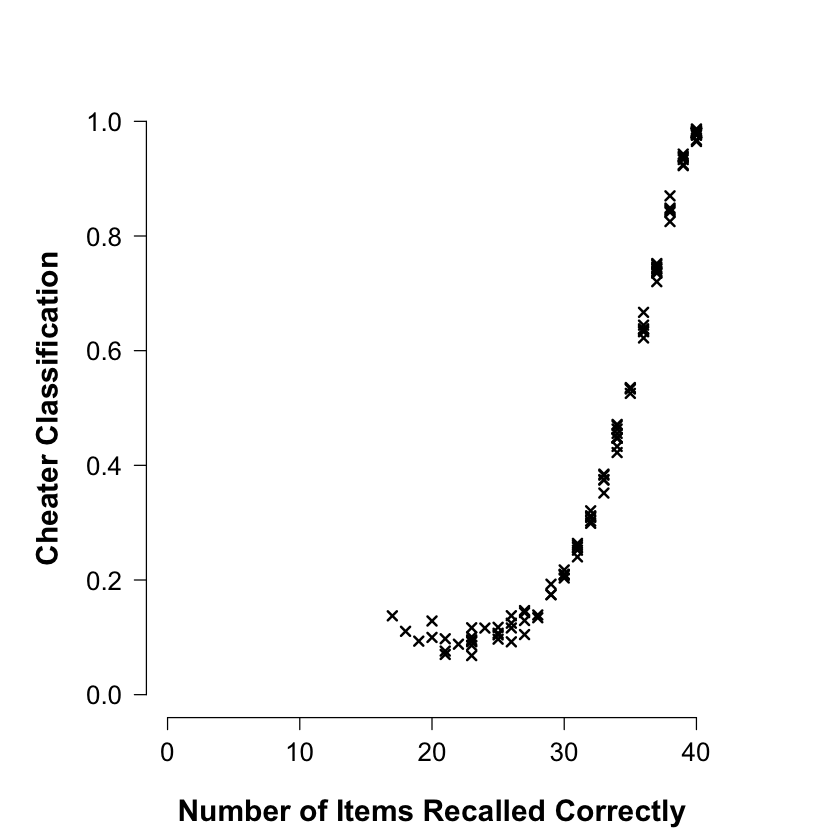

In [166]:
# plot 6.10
par(cex.main = 1.5, mar = c(5, 6, 4, 5) + 0.1, mgp = c(3.5, 1, 0), cex.lab = 1.5,
    font.lab = 2, cex.axis = 1.3, bty = "n", las=1)
plot(k,samples$BUGSoutput$mean$z,ylim=c(0,1),xlim=c(0,n), xlab= "Number of Items Recalled Correctly", 
     ylab="Cheater Classification", lwd=2, pch=4) 
#in the code, z=0 is bonafide and z=1 is cheating
#so z gives the prob of being assigned to cheating group

### Stan Code

In [167]:
model <- "
// Cheating Latent Mixture Model
data { 
  int<lower=1> n;
  int<lower=1> p;
  int<lower=1,upper=n> k[p];
  int<lower=0,upper=1> truth[p];
}
parameters {
  real<lower=0,upper=1> phi;
  real<lower=0,upper=1> mubon;
  real<lower=0> mudiff;
  real<lower=5,upper=50> lambdabon;
  real<lower=5,upper=50> lambdache;
  vector<lower=0,upper=1>[p] theta;
} 
transformed parameters {
  vector[2] lp_parts[p];
  vector<lower=0>[2] alpha;
  vector<lower=0>[2] beta;
  real<lower=0,upper=1> muche;
    
  // Additivity on Logit Scale
  muche <- inv_logit(logit(mubon) + mudiff);
  
  // Transformation to Group Mean and Precision
  alpha[1] <- mubon * lambdabon;
  beta[1] <- lambdabon * (1 - mubon);
  alpha[2] <- muche * lambdache;
  beta[2]  <- lambdache * (1 - muche);
    
  // Data are Binomial with Rate Given by 
  // Each Person’s Group Assignment
  for (i in 1:p) {
    lp_parts[i,1] <- log1m(phi) + beta_log(theta[i], alpha[1], beta[1]);
    lp_parts[i,2] <- log(phi) + beta_log(theta[i], alpha[2], beta[2]);
  } 
}
model {
  // Priors
  mubon ~ beta(1, 1);  // can be removed
  mudiff ~ normal(0, 1 / sqrt(.5))T[0,];  // Constrained to be Positive
  // Relatively Uninformative Prior on Base Rate
  phi ~ beta(5, 5);
    
  for (i in 1:p)  
    increment_log_prob(log_sum_exp(lp_parts[i]));    
    
  k ~ binomial(n, theta);
}
generated quantities {
  int<lower=0,upper=1> z[p];
  real pc;
  vector[p] pct;
  
  for (i in 1:p) {
    vector[2] prob;
    prob <- softmax(lp_parts[i]);
    // Each Person Belongs to One of Two Latent Groups
    z[i] <- bernoulli_rng(prob[2]);
    // Correct Count
    pct[i] <- if_else(z[i] == truth[i], 1, 0);
  }
  pc <- sum(pct);
}"

cheat.dat  <- read.table("cheat.csv", header=F, sep=",")
cheatt.dat <- read.table("cheatt.csv", header=F, sep="")
truth <- cheatt.dat$V1  # truth = 1 if cheater
k <- apply(cheat.dat, 1, sum)  # total correct per participant
p <- length(k)  # number of people
n <- 40         # total trials

data <- list(p=p, k=k, n=n, truth=truth) # To be passed on to Stan

myinits <- list(
  list(mudiff=.1, phi=.5, mubon=.5, lambdabon=30, lambdache=25, 
       theta=rep(.5, p)),
  list(mudiff=.15, phi=.5, mubon=.5, lambdabon=25, lambdache=30,
       theta=rep(.5, p))) 

# Parameters to be monitored:
parameters <- c("theta", "z", "mubon", "lambdabon", "muche", "lambdache", 
                "mudiff", "phi", "alpha", "beta", "pc") 

# The following command calls Stan with specific options.
# For a detailed description type "?rstan".
samples <- stan(model_code=model,   
                data=data, 
                init=myinits,  # If not specified, gives random inits
                pars=parameters,
                iter=1000, 
                chains=2, 
                thin=1,
                warmup = 200,  # Stands for burn-in; Default = iter/2
                # seed = 123  # Setting seed; Default is random seed
)
# Now the values for the monitored parameters are in the "samples" object, 
# ready for inspection.


TRANSLATING MODEL 'model' FROM Stan CODE TO C++ CODE NOW.
COMPILING THE C++ CODE FOR MODEL 'model' NOW.
In file included from file3798368091.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:17:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev.hpp:5:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/agrad/rev/chainable.hpp:87:17: warning: 'static' function 'set_zero_all_adjoints' declared in header file should be declared 'static inline' [-Wunneeded-internal-declaration]
    static void set_zero_all_adjoints() {
                ^
In file included from file3798368091.cpp:8:
In file included from /Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/include//stansrc/stan/model/model_header.hpp:21:
/Library/Frameworks/R.framework/Versions/3.2/Resources/library/rstan/in

In [168]:
print(samples)

Inference for Stan model: model.
2 chains, each with iter=1000; warmup=200; thin=1; 
post-warmup draws per chain=800, total post-warmup draws=1600.

               mean se_mean    sd     2.5%      25%      50%      75%    97.5%
theta[1]       0.67    0.00  0.07     0.53     0.63     0.67     0.72     0.80
theta[2]       0.61    0.00  0.07     0.48     0.57     0.62     0.66     0.74
theta[3]       0.96    0.00  0.03     0.89     0.95     0.97     0.98     1.00
theta[4]       0.84    0.00  0.06     0.71     0.80     0.84     0.88     0.93
theta[5]       0.71    0.00  0.06     0.58     0.67     0.71     0.75     0.83
theta[6]       0.61    0.00  0.07     0.48     0.57     0.62     0.66     0.75
theta[7]       0.89    0.00  0.05     0.78     0.86     0.89     0.92     0.96
theta[8]       0.79    0.00  0.06     0.67     0.75     0.79     0.83     0.89
theta[9]       0.73    0.00  0.06     0.60     0.69     0.73     0.77     0.84
theta[10]      0.77    0.00  0.06     0.64     0.72     0.77 

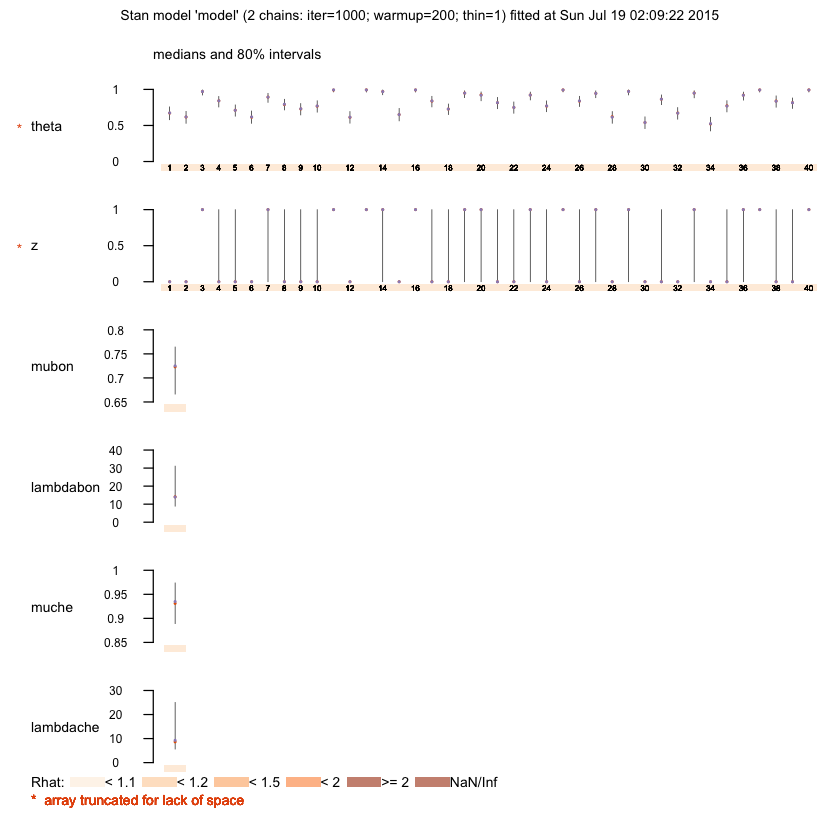

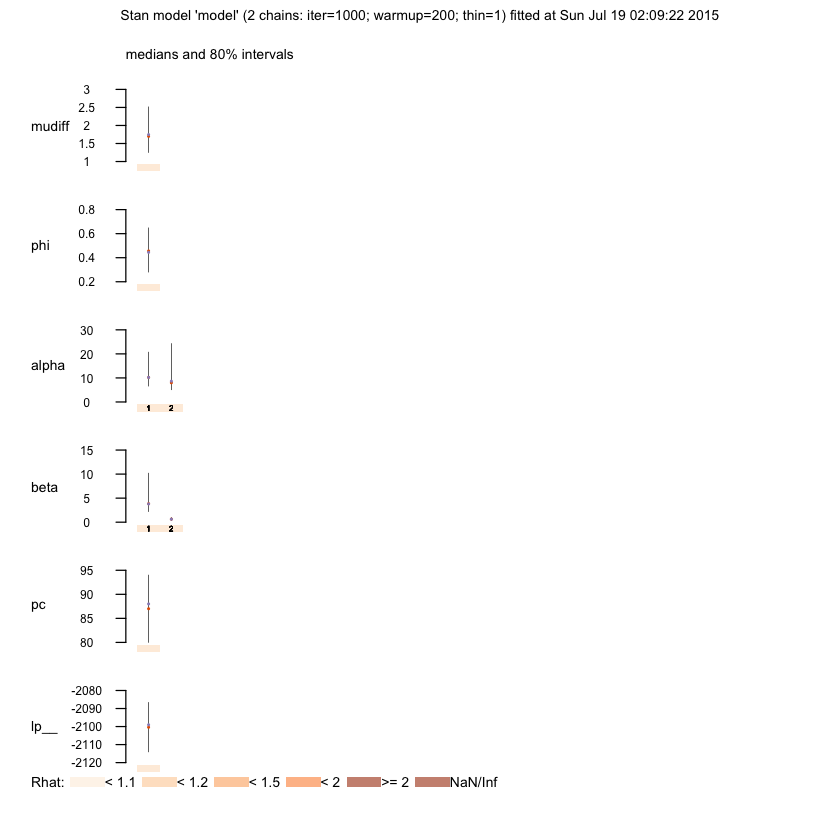

In [169]:
plot(samples)

In [170]:
pc <- extract(samples)$pc / p  # to get proportion correct
mean(pc)

[1] 0.7403231

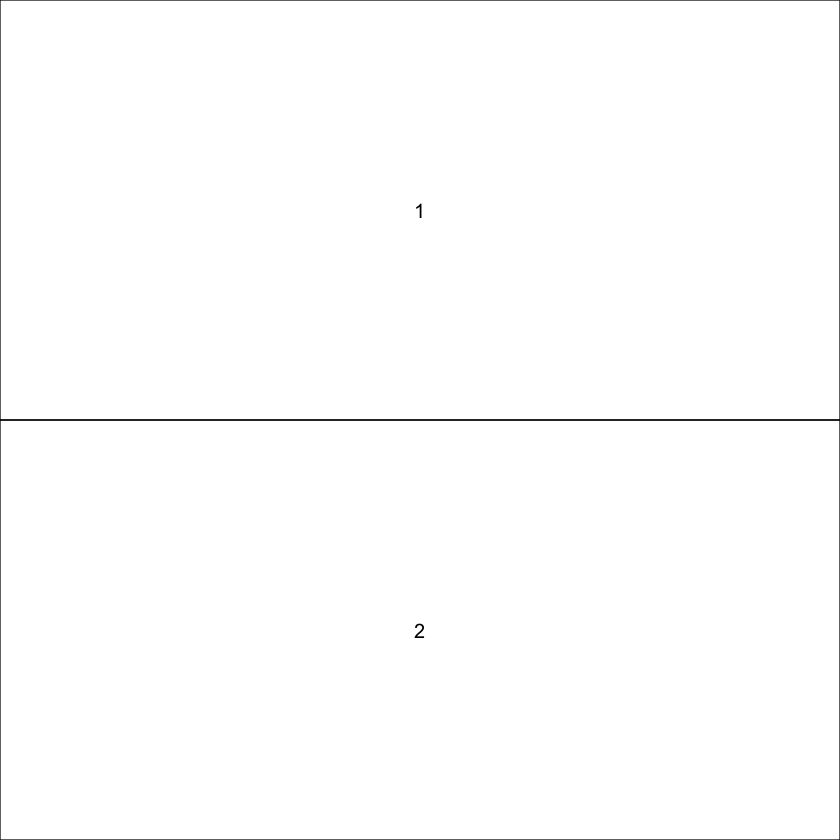

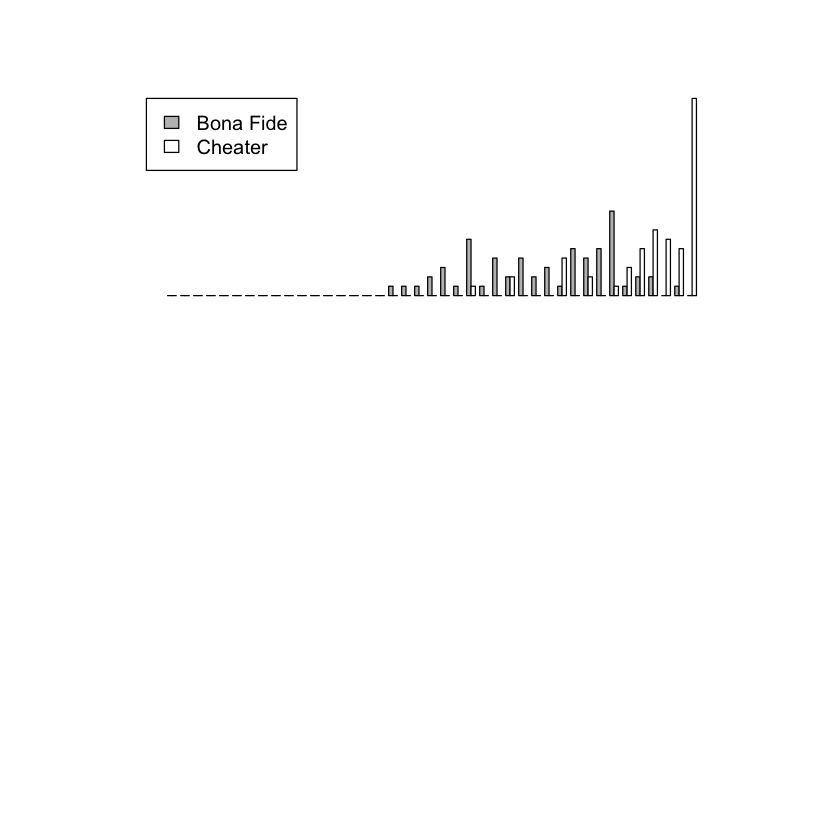

In [178]:
# plot 6.9
#make the two panel plot:
#windows(width=8,height=6) #this command works only under Windows!
layout(matrix(c(1,2),2,1))
layout.show(2)
par(cex.main = 1.5, mar = c(5, 6, 4, 5) + 0.1, mgp = c(3.5, 1, 0), cex.lab = 1.5,
    font.lab = 2, cex.axis = 1.3, bty = "n", las=1)
bins <- c(-1:n)+.5
bonafide <- hist(k[truth==0], breaks=bins, plot=F)$counts
cheat    <- hist(k[truth==1], breaks=bins, plot=F)$counts

counts <- rbind(bonafide, cheat)
barplot(counts, main=" ", xlab=" ", col=c("grey","white"),
  legend.text = c("Bona Fide","Cheater"), args.legend = list(x="topleft"),
  beside=TRUE, axes=F)

# bottom panel:
par(cex.main = 1.5, mar = c(5, 6, 4, 5) + 0.1, mgp = c(3.5, 1, 0), cex.lab = 1.5,
    font.lab = 2, cex.axis = 1.3, bty = "n", las=1)
pc.line <- array()
for (i in 1:41) {
  pc.line[i] <- mean((k>=(i-1))==truth)
}

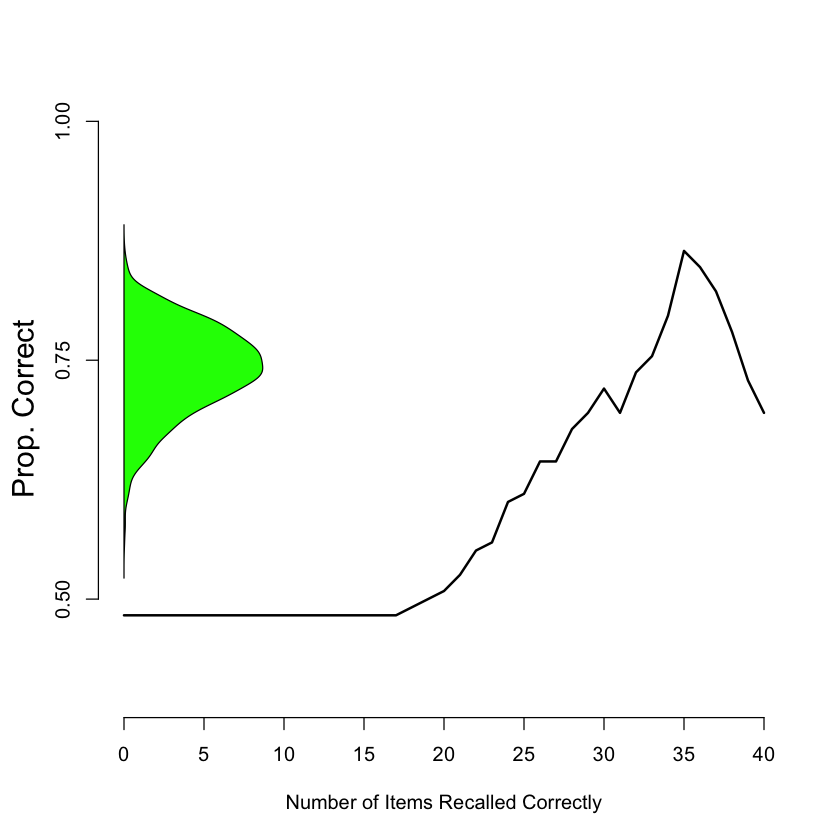

In [172]:
#dev.new() # so the plot below does not overwrite the plot above

plot(c(0:40), pc.line, type="l", lwd=2, xlim=c(0,40), ylim=c(0.4,1), 
     xlab="Number of Items Recalled Correctly", 
     ylab=" ", axes=F)
axis(1, at=c(0,seq(from=5,by=5,to=40)))
axis(2, at=c(.5,.75,1))
par(las=0)
mtext("Prop. Correct",side=2, line=2.5,cex=1.5)
# Now add the distribution:
pc.dens <- density(pc)
polygon(c(0,pc.dens$y,0,0), c(pc.dens$x[1]-.01,pc.dens$x,pc.dens$x[1]+.01,
                              pc.dens$x[1]-.01), col="green")


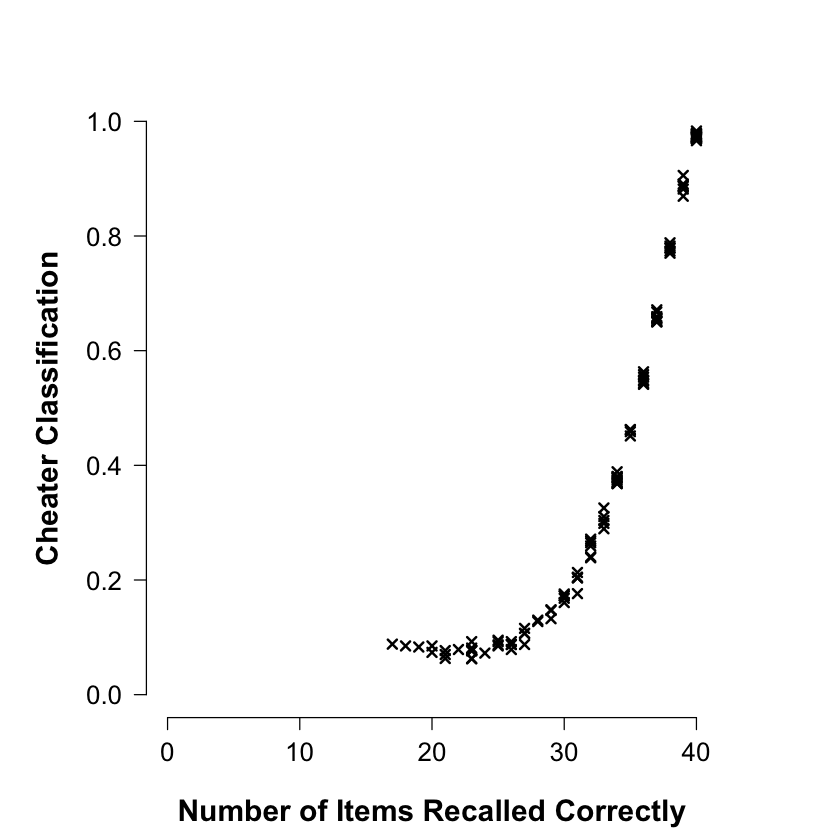

In [173]:
# plot 6.10
#windows()
par(cex.main = 1.5, mar = c(5, 6, 4, 5) + 0.1, mgp = c(3.5, 1, 0), cex.lab = 1.5,
    font.lab = 2, cex.axis = 1.3, bty = "n", las=1)
plot(k,summary(samples)$summary[paste("z[", 1:118, "]", sep=""), 1], ylim=c(0,1),
     xlim=c(0,n), lwd=2, pch=4, xlab= "Number of Items Recalled Correctly", 
     ylab="Cheater Classification") 
# in the code, z=0 is bonafide and z=1 is cheating
# so z gives the prob of being assigned to cheating group



# 참고자료 

* [1] Bayesian Cognitive Modeling: A Practical Course - http://www.amazon.com/Bayesian-Cognitive-Modeling-Practical-Course/dp/1107603579/
* [2] codes(winbugs, jags) - http://bayesmodels.com/
* [3] codes(stan) - https://github.com/stan-dev/example-models/tree/master/Bayesian_Cognitive_Modeling